In [5]:
############# 0. ABRO DATOS #############

#Librerias
import os
import pandas as pd
import numpy as np

#Directorios
cwd = os.getcwd()
print("Current working directory: {0}".format(cwd))
#si estoy trabajando desde el servidor vegeta
ruta_a_archivos_smn = "/pikachu/datos/nadia.testani/Doctorado/datos/smn/smn_variables_1961-2021/" #ruta donde estan los archivos con datos del smn
ruta_a_archivo_estaciones_smn = "/pikachu/datos/nadia.testani/Doctorado/datos/smn/" 
ruta_a_resultados = "/pikachu/datos/nadia.testani/Doctorado/resultados/resultados2023/temperatura_rango" #ruta donde se guardan los resultados del analisis de nubosidad

#Abro datos
#Abro datos de Tmin Tmax juntas porque lo voy a usar para calcular el rango de T 
from f_abrir_datos_smn import abrir_datos_smn
nombres_archivos = os.listdir(ruta_a_archivos_smn)
datos_tmin_tmax = {}
for nombre_archivo in nombres_archivos:
    id_data = abrir_datos_smn(ruta_a_archivos = ruta_a_archivos_smn, nombre_archivo = nombre_archivo, 
                              variable = ["tmin", "tmax"])
    datos_tmin_tmax[id_data[0]] = id_data[1]

#control de calidad: elimino los eliminados en el control de calidad de tmin y de tmax

#tmax
datos_tmin_tmax[87270]["tmax"][datos_tmin_tmax[87270].index == "2020-09-26"] = np.nan
datos_tmin_tmax[87270]["tmax"][datos_tmin_tmax[87270].index == "2020-09-30"] = np.nan
datos_tmin_tmax[87395]["tmax"][datos_tmin_tmax[87395].index == "1962-11-28"] = np.nan
datos_tmin_tmax[87187]["tmax"][datos_tmin_tmax[87187].index == "1972-12-25"] = np.nan
datos_tmin_tmax[87187]["tmax"][datos_tmin_tmax[87187].index == "1990-05-22"] = np.nan
datos_tmin_tmax[87148]["tmax"][datos_tmin_tmax[87148].index == "2002-01-21"] = np.nan
datos_tmin_tmax[87148]["tmax"][datos_tmin_tmax[87148].index == "2008-01-23"] = np.nan

#tmin
datos_tmin_tmax[87289]["tmin"][datos_tmin_tmax[87289].index == "2019-10-01"] = np.nan
datos_tmin_tmax[87166]["tmin"][datos_tmin_tmax[87166].index == "1976-03-28"] = np.nan
datos_tmin_tmax[87166]["tmin"][datos_tmin_tmax[87166].index == "1980-04-16"] = np.nan
datos_tmin_tmax[87166]["tmin"][datos_tmin_tmax[87166].index == "1995-10-14"] = np.nan
datos_tmin_tmax[87395]["tmin"][datos_tmin_tmax[87395].index == "1965-11-03"] = np.nan
datos_tmin_tmax[87395]["tmin"][datos_tmin_tmax[87395].index == "2018-12-08"] = np.nan
datos_tmin_tmax[87155]["tmin"][datos_tmin_tmax[87155].index == "1971-04-25"] = np.nan
datos_tmin_tmax[87187]["tmin"][datos_tmin_tmax[87187].index == "1985-12-25"] = np.nan
datos_tmin_tmax[87187]["tmin"][datos_tmin_tmax[87187].index == "1997-02-13"] = np.nan
datos_tmin_tmax[87148]["tmin"][datos_tmin_tmax[87148].index == "1969-02-20"] = np.nan
datos_tmin_tmax[87148]["tmin"][datos_tmin_tmax[87148].index == "2014-12-03"] = np.nan

#Abro archivo con informacion sobre estaciones SMN
estaciones_smn = pd.read_excel(f"{ruta_a_archivo_estaciones_smn}Exp185151.xlsx", sheet_name = "Estaciones", 
                               names = ["EST", "NOMBRE", "LAT", "LON", "ALT"]) #smn

# Corrijo puntos manualmente 
#monte caseros
estaciones_smn.loc[estaciones_smn.EST == 87393, 'LAT'] = 30.27078
estaciones_smn.loc[estaciones_smn.EST == 87393, 'LON'] = 57.64046
#reconquista aero
estaciones_smn.loc[estaciones_smn.EST == 87270, 'LAT'] = 29.20159
estaciones_smn.loc[estaciones_smn.EST == 87270, 'LON'] = 59.69280
#paso de los libres aero
estaciones_smn.loc[estaciones_smn.EST == 87289, 'LAT'] = 29.68796
estaciones_smn.loc[estaciones_smn.EST == 87289, 'LON'] = 57.15317
#posadas aero
estaciones_smn.loc[estaciones_smn.EST == 87178, 'LAT'] = 27.39170
estaciones_smn.loc[estaciones_smn.EST == 87178, 'LON'] = 55.96673
#corrientes aero
estaciones_smn.loc[estaciones_smn.EST == 87166, 'LAT'] = 27.44915
estaciones_smn.loc[estaciones_smn.EST == 87166, 'LON'] = 58.75830
#concordia aero
estaciones_smn.loc[estaciones_smn.EST == 87395, 'LAT'] = 31.30297
estaciones_smn.loc[estaciones_smn.EST == 87395, 'LON'] = 58.00242
#resistencia aero
estaciones_smn.loc[estaciones_smn.EST == 87155, 'LAT'] = 27.44478
estaciones_smn.loc[estaciones_smn.EST == 87155, 'LON'] = 59.04856
#obera
estaciones_smn.loc[estaciones_smn.EST == 87187, 'LAT'] = 27.48733
estaciones_smn.loc[estaciones_smn.EST == 87187, 'LON'] = 55.12099
#roque saenz peña
estaciones_smn.loc[estaciones_smn.EST == 87148, 'LAT'] = 26.74565
estaciones_smn.loc[estaciones_smn.EST == 87148, 'LON'] = 60.48277
#mercedes
estaciones_smn.loc[estaciones_smn.EST == 87281, 'LAT'] = -29.22248
estaciones_smn.loc[estaciones_smn.EST == 87281, 'LON'] = -58.08762
#ituzaingo 
estaciones_smn.loc[estaciones_smn.EST == 87173, 'LAT'] = -27.58890
estaciones_smn.loc[estaciones_smn.EST == 87173, 'LON'] = -56.68925

Current working directory: /home/nadia.testani/Doctorado/codigos/codigos2023


In [6]:
###### Calculo rango de temperatura diaria (restas con alguno nan quedan nan ######
datos_tmin_tmax_rango = datos_tmin_tmax.copy()
for ide in estaciones_smn.EST:
    datos_tmin_tmax_rango[ide]["trango"] = datos_tmin_tmax_rango[ide]["tmax"]-datos_tmin_tmax_rango[ide]["tmin"]    

In [7]:
############# 1. COMPUTO DATOS DIARIOS FALTANTES #############
#si falta o tmax o tmin entonces se computa como dato faltante por la resta que ya se hizo 
#extraigo la fecha de la primer y ultima medicion y calculo porcentaje de datos faltantes y lo acomodo en una tabla
import datetime as dt
datos_smn = datos_tmin_tmax_rango
variable = "trango"
print(f"CREATE TABLE INFO TRANGO")
print("\n")
codigos = list(estaciones_smn.EST)
nombres = ["Mercedes Aero", "Monte Caseros Aero", "Reconquista Aero", "Paso de los Libres Aero",
           "Posadas Aero", "Corrientes Aero", "Concordia Aero", "Resistencia Aero", "Ituzaingó", 
           "Oberá", "Presidencia Roque Saenz Peña Aero"]
lons = list(round(estaciones_smn.LON, 3))
lats = list(round(estaciones_smn.LAT,3))
alts = list(estaciones_smn.ALT)
fechas_0 = [str(datos_smn[cod].index[0].month) +"/" + str(datos_smn[cod].index[0].year) for cod in codigos]
fechas_menos1 = [str(datos_smn[cod].index[-1].month) +"/" + str(datos_smn[cod].index[-1].year) for cod in codigos]
porcentajes_faltantes = [round(datos_smn[cod].isnull()[variable].sum()/len(datos_smn[cod][variable])*100, 3) for cod in codigos]

#defino fechas climatologicas y para estudios a largo plazo, sale de trabajo con nubosidad
fechas_climatologicas = pd.date_range(start="1983-12-01",end="2016-11-30")
fechas_largo_plazo = pd.date_range(start="1961-03-01",end="2021-02-28")

porcentajes_faltantes_1983_2016 = [round(datos_smn[cod]["1983-12-01":"2016-11-30"].isnull()[variable].sum()/len(fechas_climatologicas)*100, 3) for cod in codigos]
porcentajes_faltantes_1961_2021 = [round(datos_smn[cod]["1961-03-01":"2021-02-28"].isnull()[variable].sum()/len(fechas_largo_plazo)*100, 3) for cod in codigos]

tabla_info_estaciones = pd.DataFrame({"Name": nombres,
                                      "Code": codigos,
                                      "Longitude [º]": lons,
                                      "Latitude [º]": lats,
                                      "Elevation [m]": alts,
                                      "Initial Date [mm/yyyy]":fechas_0,
                                      "Final Date [mm/yyyy]":fechas_menos1,
                                      f"Missing values (Initial-Final Date) [%]": porcentajes_faltantes,
                                      f"Missing values (1983-12-01 - 2016-11-30) [%]": porcentajes_faltantes_1983_2016,
                                      f"Missing values (1961-03-01 - 2021-02-28) [%]": porcentajes_faltantes_1961_2021})

#tabla_info_estaciones[["Name","Missing values (Initial-Final Date) [%]",
#                      "Missing values (1983-12-01 - 2016-11-30) [%]",
#                      "Missing values (1961-03-01 - 2021-02-28) [%]"]]

tabla_info_estaciones

CREATE TABLE INFO TRANGO




,Name,Code,Longitude [º],Latitude [º],Elevation [m],Initial Date [mm/yyyy],Final Date [mm/yyyy],Missing values (Initial-Final Date) [%],Missing values (1983-12-01 - 2016-11-30) [%],Missing values (1961-03-01 - 2021-02-28) [%]
0,Mercedes Aero,87281,-58.088,-29.222,107,1/1961,11/2021,77.486,86.569,78.316
1,Monte Caseros Aero,87393,57.640,30.271,54,1/1961,11/2021,0.607,0.489,0.616
2,Reconquista Aero,87270,59.693,29.202,53,1/1961,11/2021,1.903,0.315,1.930
3,Paso de los Libres Aero,87289,57.153,29.688,70,1/1961,11/2021,3.293,1.070,3.340
4,Posadas Aero,87178,55.967,27.392,125,1/1961,11/2021,1.152,0.124,0.899
5,Corrientes Aero,87166,58.758,27.449,62,11/1961,11/2021,6.040,7.699,6.042
6,Concordia Aero,87395,58.002,31.303,38,10/1962,11/2021,0.375,0.274,0.370
7,Resistencia Aero,87155,59.049,27.445,52,7/1964,11/2021,3.976,4.538,3.796
8,Ituzaingó,87173,-56.689,-27.589,72,7/1962,11/2021,38.561,26.257,37.974
9,Oberá,87187,55.121,27.487,303,1/1961,11/2021,13.129,6.620,13.028


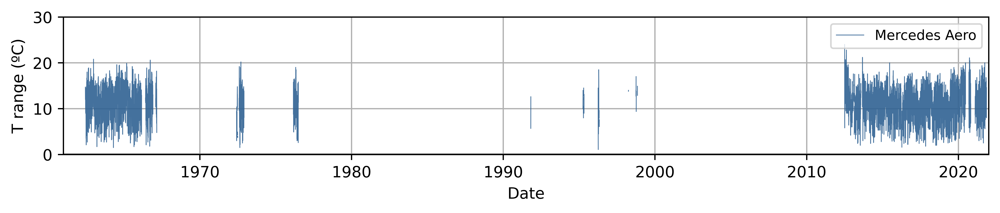

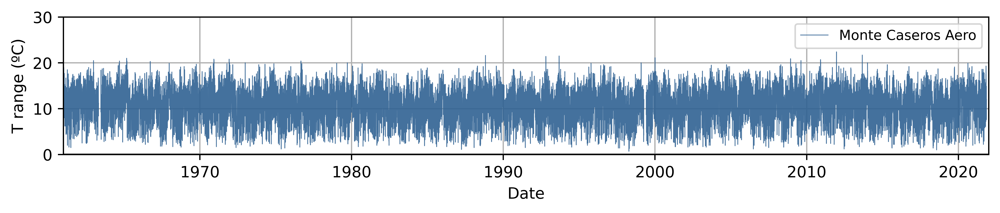

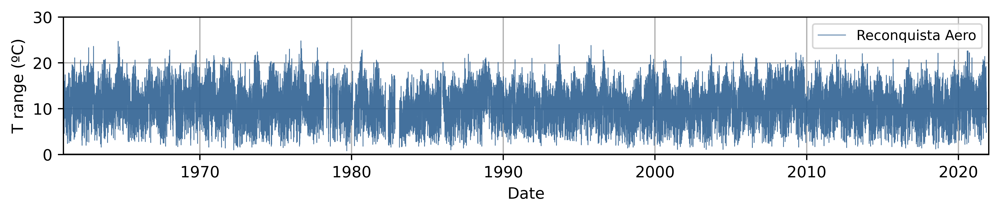

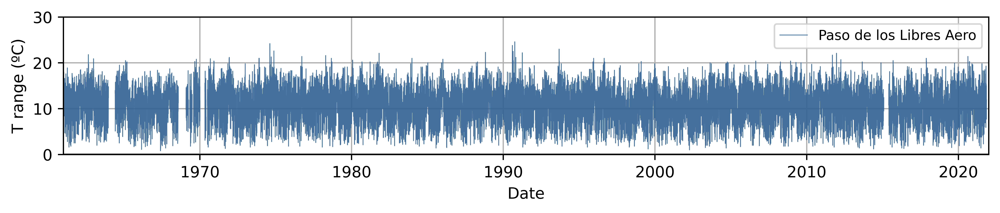

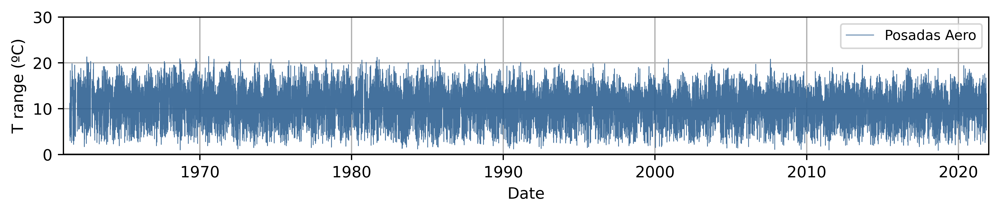

...

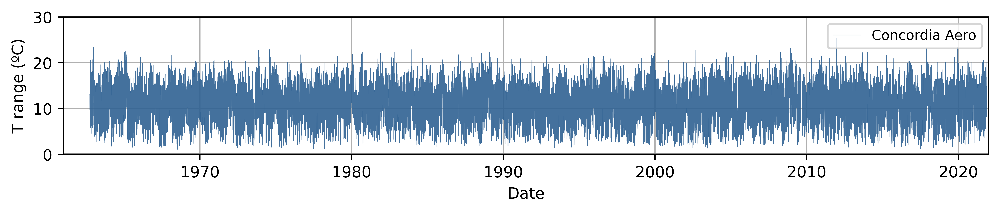

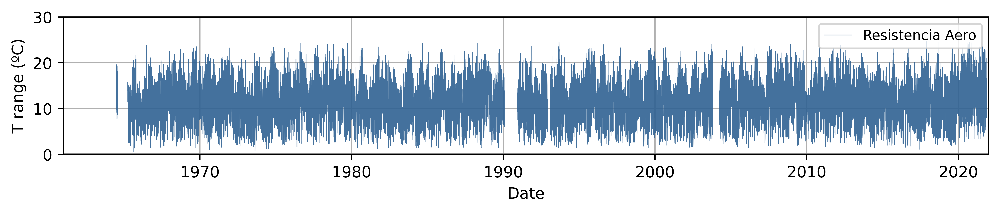

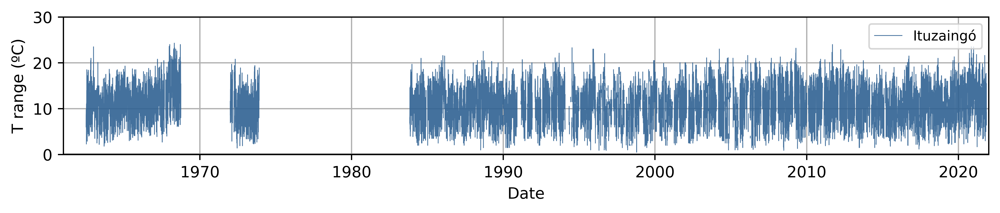

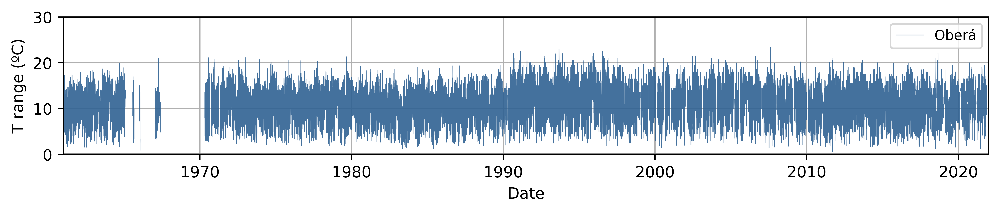

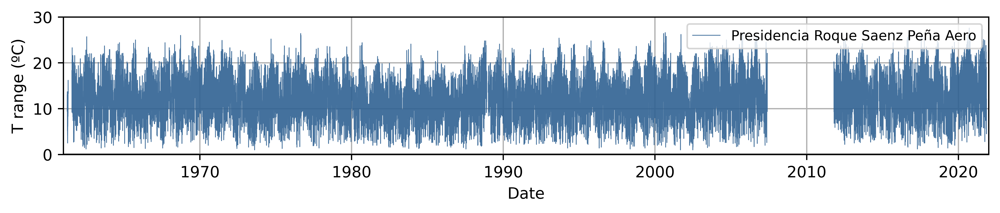

In [8]:
############# 1. GRAFICO SERIES DIARIAS PARA VER DONDE ESTAN LOS DATOS FALTANTES #############
import matplotlib.pyplot as plt

#figura
def f_plot_control_calidad(num):
    fig = plt.figure(num=1, figsize=(9, 2), dpi=900) #(9, 2)
    plt.subplot(1, 1, 1)
    plt.plot(datos_smn[tabla_info_estaciones["Code"][num]]["trango"], color = "#306292", linewidth = 0.5, alpha = 0.9)
    ylim = 30
    plt.ylim((0,ylim))
    plt.ylabel("T range (ºC)")
    plt.xlim((dt.datetime(year=1961,month=1, day=1),dt.datetime(year=2022,month=1, day=1)))
    plt.xlabel("Date")  
    plt.axhline(y=0, color='grey', linestyle='-')
    plt.legend([tabla_info_estaciones["Name"][num]], loc ="upper right", ncol=2, prop={'size': 8.8})
    plt.grid()
    plt.tight_layout()
    return(fig)

for num in range(0,11):
    f_plot_control_calidad(num)
    plt.show()

## Hago climatologia

In [9]:
import numpy as np
import pandas as pd
import datetime as dt
from calendar import monthrange

def f_media_mensual_smn(id_omm, df_data, na = 20, nombre_variable = "nub"):
    """ construye serie de media mensual y lo guarda en ruta_salida como .csv
    admite el na% de datos faltantes"""

    data_group=df_data[nombre_variable].groupby(pd.Grouper(freq="M"))
    data_group_media=data_group.mean() #hace la media aunque halla nans, a menos que todo el mes tenga nans
    data_group_faltantes = df_data[nombre_variable].isnull().groupby(pd.Grouper(freq="M")).sum() #agregue [nombre_variable]
    data_group_size = data_group.size()
    posiciones_medias_a_conservar = data_group_faltantes.values <= data_group_size.values * na/100
    # elif na == 
    #me quedo con los meses donde la cantidad de datos faltantes haya sido menor al na% de los datos para el mes
    media = []
    for i, elemento in enumerate(data_group_media):
        if posiciones_medias_a_conservar[i] == True: # and pd.isna(elemento)!=True: # elimine [i][0]
            media.append(elemento) #media.append(round(elemento)) 
        else:
            media.append(np.nan)
    indices=data_group_media.index
    media_mensual_df=pd.DataFrame(media, index = indices)
    media_mensual_df.index.name = "fecha"
    return media_mensual_df


In [10]:
############# SERIES MENSUALES #############

#calculo series de medias mensuales de cada estacion
#los meses con mas de 20% de datos faltantes se computan como NA
porcentaje_na_admitido = 20
medias_mensuales_smn = {} #genero diccionario donde se van a guardar las medias mensuales
for id_omm in tabla_info_estaciones["Code"]:
    media_mensual_df = f_media_mensual_smn(id_omm, datos_smn[id_omm], porcentaje_na_admitido, "trango") #uso funcion f_media_mensual_smn en f_paper_nubosidad_NEA
    medias_mensuales_smn[id_omm] = media_mensual_df

In [13]:
#guardo series mensuales
medias_mensuales_smn_df = pd.concat(medias_mensuales_smn, axis = 1)
medias_mensuales_smn_df.columns  = [medias_mensuales_smn_df.columns[i][0] for i in range(0,len(list(medias_mensuales_smn_df.columns)))]

#los guardo
print(f"CHANGE THE WORKING DIRECTORY TO: {ruta_a_resultados}")
os.chdir(ruta_a_resultados) #se para en ruta general de resultados de nubosidad
print("\n")

print("SAVE Trango_media_mensual_SMN.csv")
medias_mensuales_smn_df.to_csv("Trango_media_mensual_SMN.csv")

print("\n")
#vuelvo a ruta principal
os.chdir("../../../../../../../../home/nadia.testani/Doctorado/codigos/codigos2023") #codigos/codigos2021/nubosidad")  #VER
cwd = os.getcwd()
print("CHANGE THE WORKING DIRECTORY: {0}".format(cwd))

CHANGE THE WORKING DIRECTORY TO: /pikachu/datos/nadia.testani/Doctorado/resultados/resultados2023/temperatura_rango


SAVE Trango_media_mensual_SMN.csv


CHANGE THE WORKING DIRECTORY: /home/nadia.testani/Doctorado/codigos/codigos2023


In [37]:
############# SERIES MENSUALES --> DATOS FALTANTES#############
import datetime as dt

print(f"CREATE TABLE INFO TRANGO MENSUAL")
print("\n")

codigos = list(estaciones_smn.EST)
nombres = ["Mercedes Aero", "Monte Caseros Aero", "Reconquista Aero", "Paso de los Libres Aero",
           "Posadas Aero", "Corrientes Aero", "Concordia Aero", "Resistencia Aero", "Ituzaingó", 
           "Oberá", "Presidencia Roque Saenz Peña Aero"]
lons = list(round(estaciones_smn.LON, 3))
lats = list(round(estaciones_smn.LAT,3))
alts = list(estaciones_smn.ALT)
fechas_0 = [str(datos_smn[cod].index[0].month) +"/" + str(datos_smn[cod].index[0].year) for cod in codigos]
fechas_menos1 = [str(datos_smn[cod].index[-1].month) +"/" + str(datos_smn[cod].index[-1].year) for cod in codigos]
porcentajes_faltantes = [round(medias_mensuales_smn[cod].isnull()[0].sum()/len(medias_mensuales_smn[cod][0])*100, 3) for cod in codigos]

#defino fechas climatologicas y para estudios a largo plazo, sale de trabajo con nubosidad
fechas_climatologicas = pd.date_range(start="1983-12",end="2016-12", freq = "M")
fechas_largo_plazo = pd.date_range(start="1961-03",end="2021-03", freq = "M")

porcentajes_faltantes_1983_2016 = [round(medias_mensuales_smn[cod]["1983-12":"2016-11"].isnull()[0].sum()/len(fechas_climatologicas)*100, 3) for cod in codigos]
porcentajes_faltantes_1961_2021 = [round(medias_mensuales_smn[cod]["1961-03":"2021-02"].isnull()[0].sum()/len(fechas_largo_plazo)*100, 3) for cod in codigos]

tabla_info_estaciones_mensuales = pd.DataFrame({"Name": nombres,
                                      "Code": codigos,
                                      "Longitude [º]": lons,
                                      "Latitude [º]": lats,
                                      "Elevation [m]": alts,
                                      "Initial Date [mm/yyyy]":fechas_0,
                                      "Final Date [mm/yyyy]":fechas_menos1,
                                      f"Missing monthly values (Initial-Final Date) [%]": porcentajes_faltantes,
                                      f"Missing monthly values (1983-12-01 - 2016-11-30) [%]": porcentajes_faltantes_1983_2016,
                                      f"Missing monthly values (1961-03-01 - 2021-02-28) [%]": porcentajes_faltantes_1961_2021})


#tabla_info_estaciones_mensuales[["Name", "Missing monthly values (Initial-Final Date) [%]",
#                                "Missing monthly values (1983-12-01 - 2016-11-30) [%]",
#                                "Missing monthly values (1961-03-01 - 2021-02-28) [%]"]]

tabla_info_estaciones_mensuales

CREATE TABLE INFO TRANGO MENSUAL




,Name,Code,Longitude [º],Latitude [º],Elevation [m],Initial Date [mm/yyyy],Final Date [mm/yyyy],Missing monthly values (Initial-Final Date) [%],Missing monthly values (1983-12-01 - 2016-11-30) [%],Missing monthly values (1961-03-01 - 2021-02-28) [%]
0,Mercedes Aero,87281,-58.088,-29.222,107,1/1961,11/2021,78.249,87.879,79.167
1,Monte Caseros Aero,87393,57.640,30.271,54,1/1961,11/2021,0.684,0.505,0.694
2,Reconquista Aero,87270,59.693,29.202,53,1/1961,11/2021,2.189,0.253,2.222
3,Paso de los Libres Aero,87289,57.153,29.688,70,1/1961,11/2021,3.557,1.010,3.611
4,Posadas Aero,87178,55.967,27.392,125,1/1961,11/2021,1.368,0.253,1.111
5,Corrientes Aero,87166,58.758,27.449,62,11/1961,11/2021,6.519,7.828,6.528
6,Concordia Aero,87395,58.002,31.303,38,10/1962,11/2021,0.423,0.505,0.417
7,Resistencia Aero,87155,59.049,27.445,52,7/1964,11/2021,4.209,4.798,4.028
8,Ituzaingó,87173,-56.689,-27.589,72,7/1962,11/2021,44.039,37.374,43.611
9,Oberá,87187,55.121,27.487,303,1/1961,11/2021,13.406,8.081,13.333


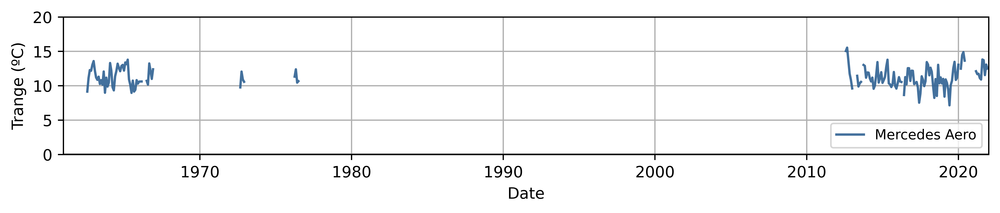

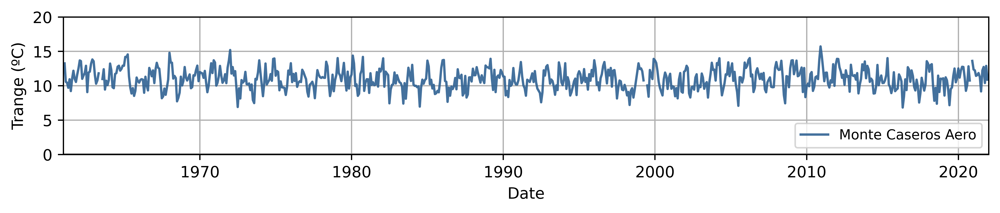

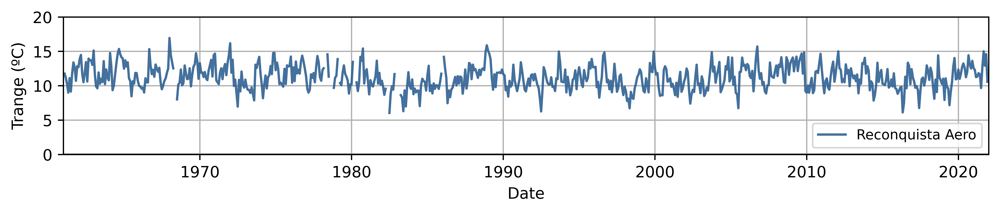

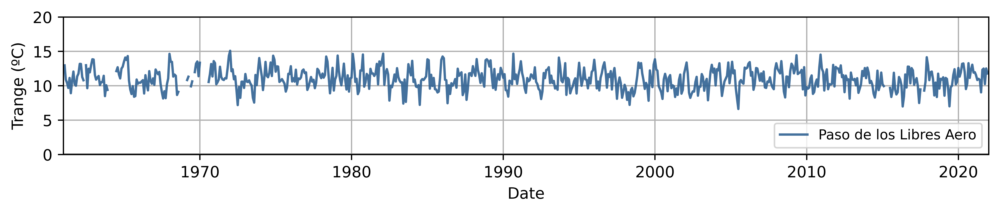

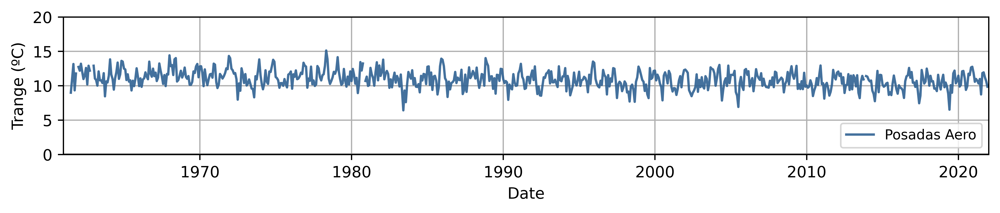

...

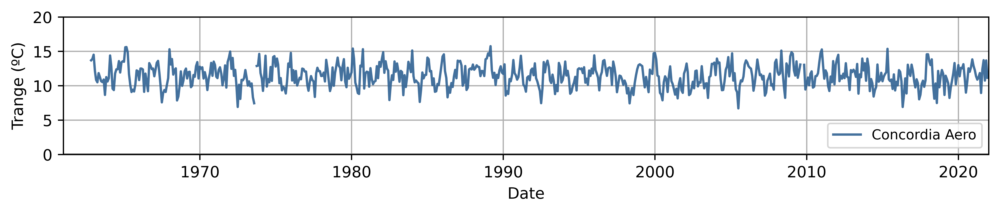

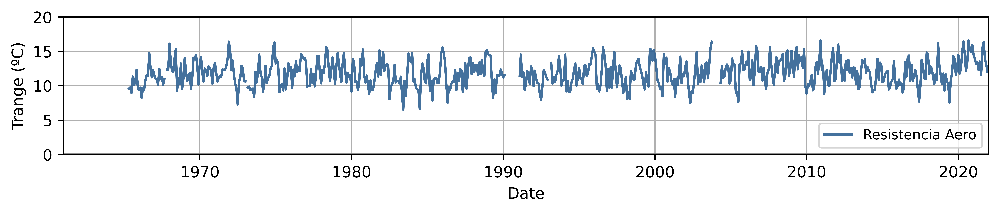

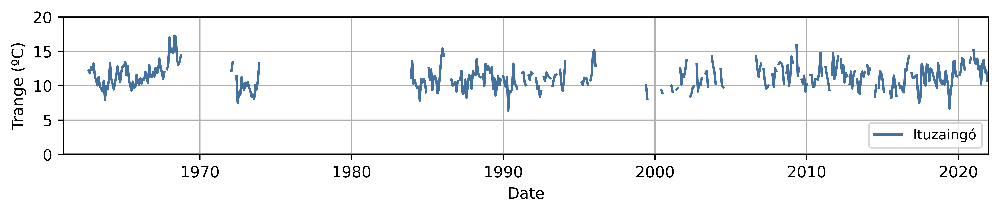

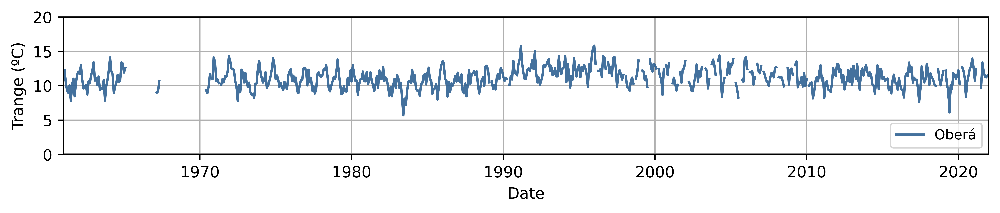

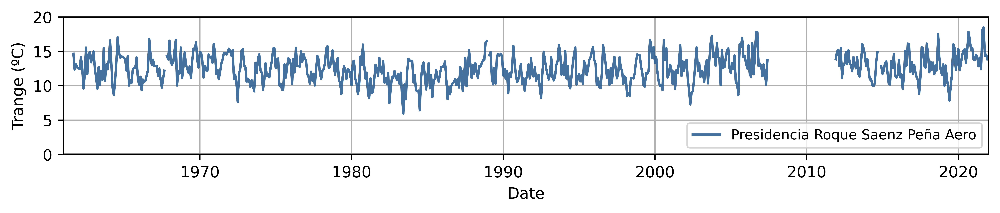

In [39]:
############# SERIES MENSUALES --> GRAFICOS#############

import matplotlib.pyplot as plt

#figura
def f_plot_control_calidad_2(num):
    fig = plt.figure(num=1, figsize=(9, 2), dpi=900)
    plt.subplot(1, 1, 1)
    plt.plot(medias_mensuales_smn[tabla_info_estaciones["Code"][num]], color = "#306292", linewidth = 1.5, alpha = 0.9)
    ylim = 20
    plt.ylim((0,ylim))
    plt.ylabel("Trange (ºC)")
    plt.xlim((dt.datetime(year=1961,month=1, day=1),dt.datetime(year=2022,month=1, day=1)))
    plt.xlabel("Date")  
    plt.axhline(y=0, color='grey', linestyle='-')
    plt.legend([tabla_info_estaciones["Name"][num]], loc ="lower right", ncol=2, prop={'size': 8.8})
    plt.grid()
    plt.tight_layout()
    return(fig)

for num in range(0,11):
    f_plot_control_calidad_2(num)
    plt.show()    

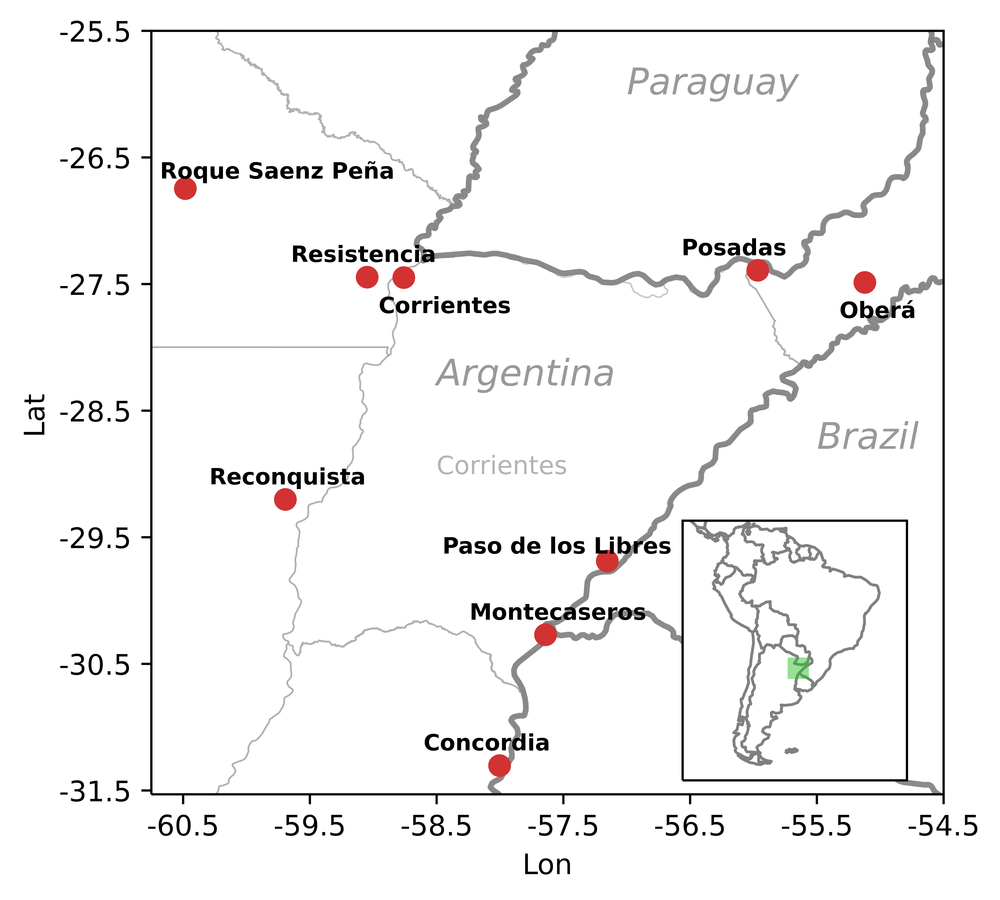

In [40]:
########### 1. MAPA CON ESTACIONES ##########
import warnings
warnings.filterwarnings("ignore") #para que muestre los warnings una sola vez

from f_mis_shapes import df_paises, df_provincias
from f_mapa import f_mapa

lista_puntos_smn = [(360 - lon, -1 * lat) for lon, lat in zip(estaciones_smn["LON"],estaciones_smn["LAT"])]
dict_puntos_smn = dict(zip(list(estaciones_smn["EST"]), lista_puntos_smn))
estaciones_ordenadas = {87148: "Roque Saenz Peña",
                        87155: "Resistencia",
                        87166: "Corrientes",
                        87178: "Posadas",
                        87270: "Reconquista", 
                        87289: "Paso de los Libres", 
                        87393: "Montecaseros", 
                        87395: "Concordia",
                        87187: "Oberá"} #solo me quedo con las que uso, saco Mercedes Aero, Ituzaingó 
ides_omm_ordenado = list(estaciones_ordenadas.keys())
nombres_ides_omm_ordenado = list(estaciones_ordenadas.values())

#cargo shapes
shape_paises = df_paises()
shape_provincias = df_provincias()

#grafico
#print(f"CHANGE THE WORKING DIRECTORY TO: {ruta_a_resultados}")
#os.chdir(ruta_a_resultados) #se para en ruta general de resultados de nubosidad
#print("\n")

#print("PLOT AND SAVE IT (use f_mapa in f_paper_nubosidad_NEA)")
f_mapa(dict_puntos_smn, ides_omm_ordenado, nombres_ides_omm_ordenado, shape_paises, shape_provincias)
plt.show()
#print("\n")
#vuelvo a ruta principal
#os.chdir("../../../../../../../../home/nadia.testani/Doctorado/codigos/codigos2021/nubosidad") #codigos/codigos2021/nubosidad")  #VER
#cwd = os.getcwd()
#print("CHANGE THE WORKING DIRECTORY: {0}".format(cwd))

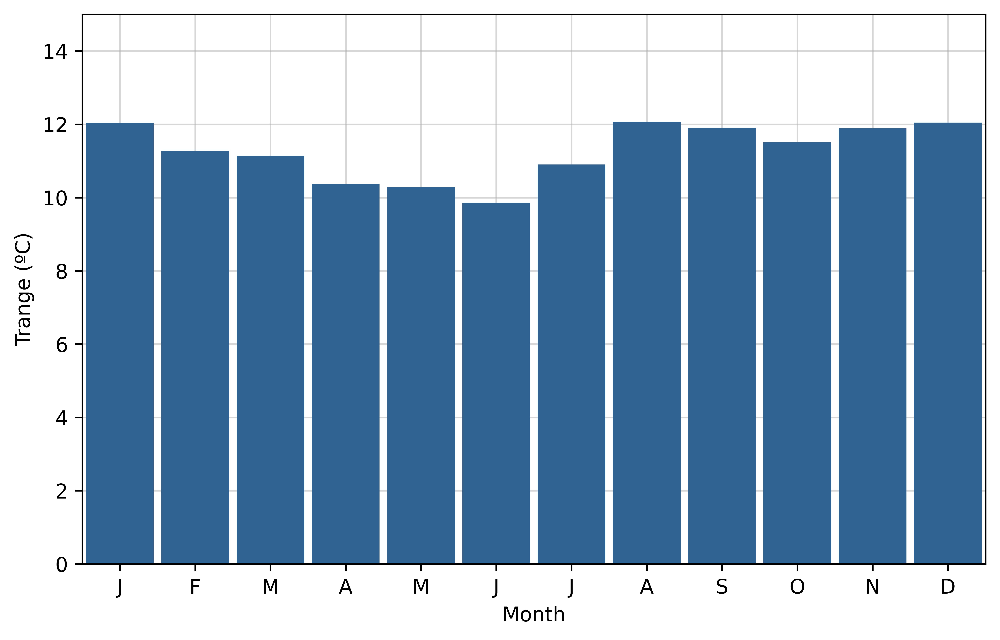

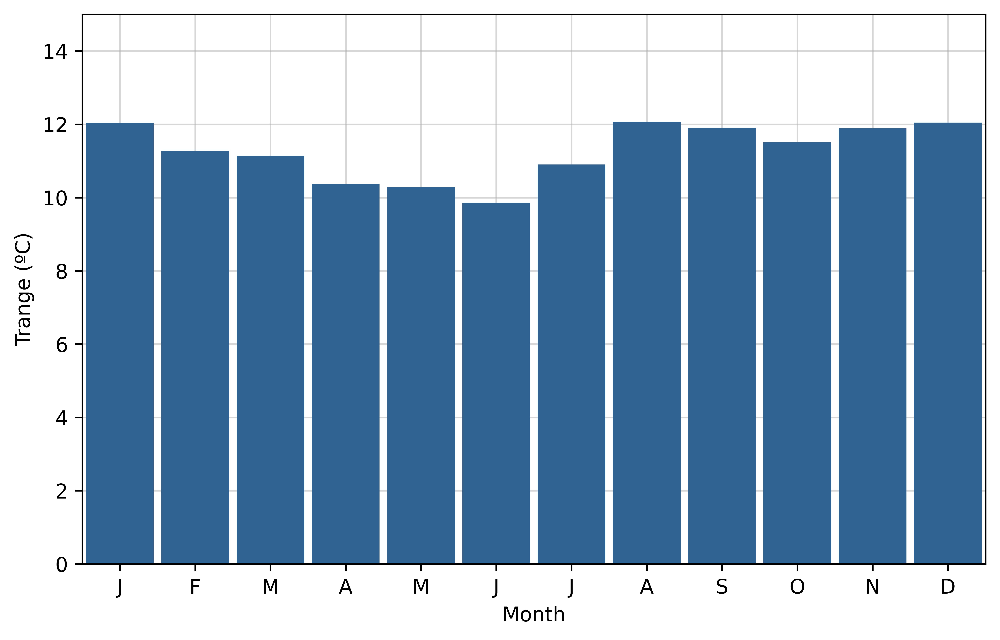

In [42]:
########### 2. CLIMATOLOGIA MEDIA REGIONAL ##########

#media regional
medias_mensuales_smn_media_regional = pd.concat(medias_mensuales_smn, axis = 1).mean(axis=1, skipna=True)

#medias climatologicas
fecha_inicio_climatologia_str = "1983-12-01"
fecha_final_climatologia_str = "2016-11-30"
medias_mensuales_smn_media_regional.index = pd.to_datetime(medias_mensuales_smn_media_regional.index)
medias_mensuales_smn_media_regional_fechas_climatologia = medias_mensuales_smn_media_regional.loc[fecha_inicio_climatologia_str:fecha_final_climatologia_str]
medias_mensuales_smn_media_regional_climatologia = medias_mensuales_smn_media_regional_fechas_climatologia.groupby(medias_mensuales_smn_media_regional_fechas_climatologia.index.month).mean() 

#las grafico
def plot_climatologia_regional():
    fig2 = plt.figure(num=1, figsize=(8, 5), dpi=1000) #genero figura
    ax = fig2.add_subplot(111) # Create matplotlib axes
    meses = ['J', 'F', 'M', 'A', 'M', "J", "J", "A", "S", "O","N", "D"] #inicial meses
    width = 0.9 #ancho de las barras
    medias_mensuales_smn_media_regional_climatologia.plot(kind='bar', color="#306292", ax=ax, width=width, zorder = 2)
    ax.set_ylabel('Trange (ºC)')
    ax.set_ylim(0, 15)
    plt.xlabel("Month")
    ax.set_xlim(-0.5, 11.5)
    ax.set_xticklabels(meses,rotation = 0)
    ax.grid(alpha = 0.5, zorder = 1)
    return(fig2)

plot_climatologia_regional()

In [43]:
########### 3. MAPA CON MEDIAS ANUALES ##########

# Calculo media anual en periodo climatológico de SMN
climatologia_anual_medias_mensuales_smn = {} 
for id_omm in ides_omm_ordenado:
    #calculo climatologia
    media_mensual_df = medias_mensuales_smn[id_omm]
    media_mensual_df.index = pd.to_datetime(media_mensual_df.index)
    media_mensual_fechas_climatologia = media_mensual_df.loc[fecha_inicio_climatologia_str:fecha_final_climatologia_str]
    media_mensual_climatologia_anual = media_mensual_fechas_climatologia.mean() 
    #Lo guardo en diccionario: climatologia_anual_medias_mensuales_smn
    climatologia_anual_medias_mensuales_smn[id_omm] = media_mensual_climatologia_anual

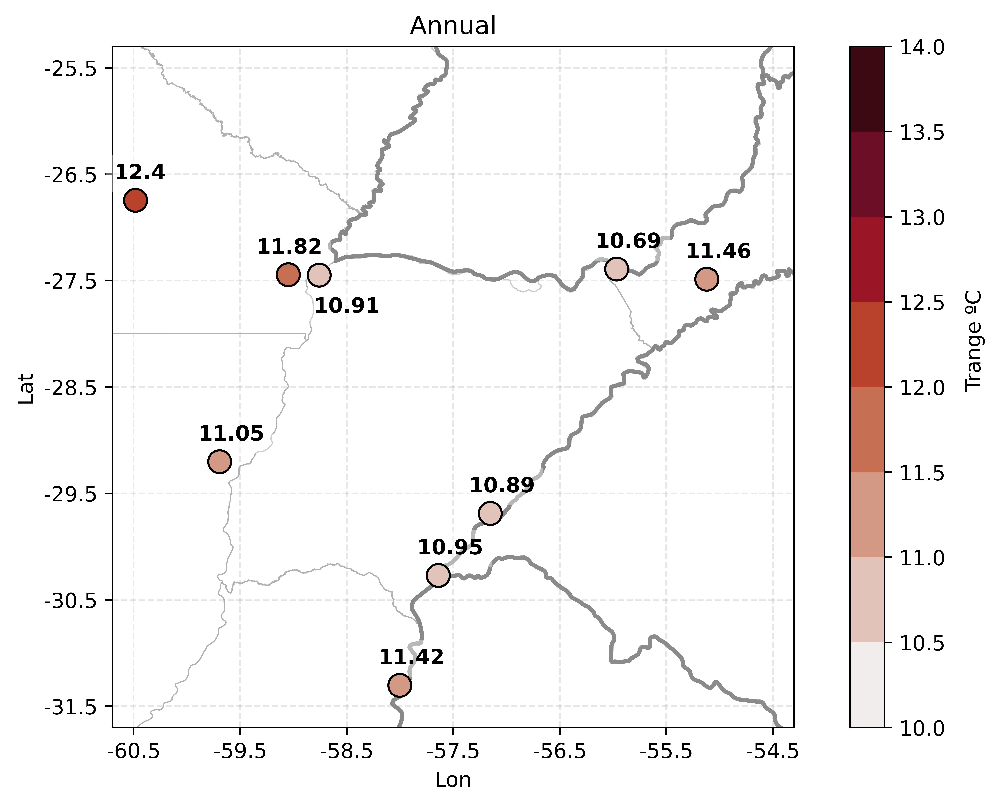

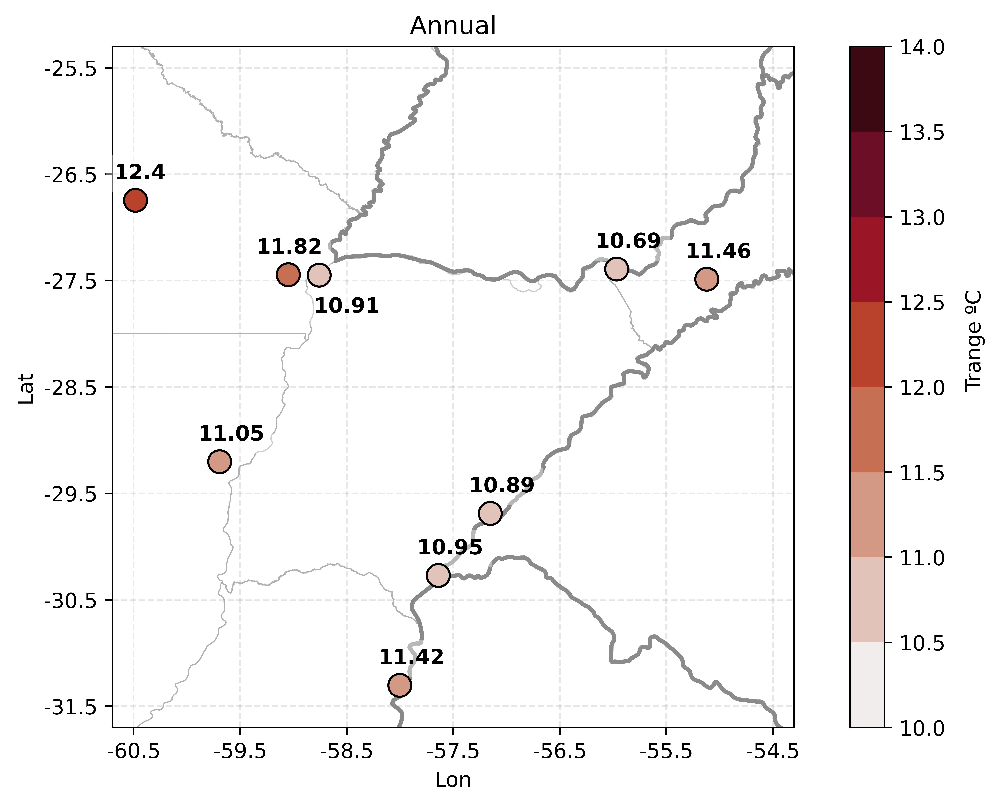

In [58]:
#Grafico
from f_mis_shapes import df_paises, df_provincias
import geopandas as gpd
from shapely.geometry import Point
import cartopy.crs as ccrs
import cmocean 
import matplotlib as mpl

#puntos que uso
lista_puntos_smn_ordenados = [dict_puntos_smn[list(estaciones_ordenadas.keys())[i]] for i in range(0,9)]
dict_puntos_smn_ordenados = zip(estaciones_ordenadas,lista_puntos_smn_ordenados)

def plot_mapa_media_anual():
    valor_minimo = 10
    valor_maximo = 14
    xticks_min = -60.5
    xticks_max = -54.5
    yticks_min = -31.5
    yticks_max = -25.5
    espacio_entre_lat_lon = 1
    medias_anuales_estaciones_ordenadas = [climatologia_anual_medias_mensuales_smn[i].values[0] for i in ides_omm_ordenado]

    #defino puntos a marcar
    geometry_3 = [Point(xy) for xy in lista_puntos_smn_ordenados] #lista con puntos 2
    geodata3 = gpd.GeoDataFrame(lista_puntos_smn_ordenados, geometry = geometry_3)
    geodata3["valores"] = medias_anuales_estaciones_ordenadas

    fig3 = plt.figure(figsize = [9.6, 6], dpi = 900)    
    ax = fig3.add_subplot(111, projection = ccrs.PlateCarree(central_longitude = 0)) #seteo proyeccion

    #agrego geometrias de fondo: provincias y paises
    ax.add_geometries(shape_provincias, crs = ccrs.PlateCarree(), facecolor = 'none',
                          edgecolor = '0.6', linewidth = 0.6, alpha = 0.5, zorder = 1)
    ax.add_geometries(shape_paises, crs = ccrs.PlateCarree(), facecolor = 'none',
                          edgecolor = '0.5', linewidth = 2, alpha = 0.7, zorder = 2)

    ##esto para discretizar la paleta:
    mi_cmap = cmocean.cm.amp # define the colormap  rain
    mi_cmaplist = [mi_cmap(i) for i in range(mi_cmap.N)] # extract all colors from the .rain map
    mi_cmap2 = mpl.colors.LinearSegmentedColormap.from_list(
        'Custom cmap', mi_cmaplist, mi_cmap.N) # create the new map
    bounds = np.linspace(valor_minimo, valor_maximo, 9) # define the bins and normalize
    norm = mpl.colors.BoundaryNorm(bounds, mi_cmap2.N)

    #ploteo valores
    geodata3.plot(column= "valores",vmin=valor_minimo, vmax=valor_maximo, 
                  markersize = 120, cmap=mi_cmap2, norm =norm, zorder=4,legend=True, ax = ax, edgecolor = "k") #limites de 0 a 8

    #agrego etiquetas con valores
    list_smn_etiquetas = [(lon-0.2-360, lat+0.25) for lon, lat in lista_puntos_smn_ordenados]
    for i, clave in enumerate(medias_anuales_estaciones_ordenadas):
        if list(estaciones_ordenadas.values())[i] != "Corrientes" and list(estaciones_ordenadas.values())[i] != "Resistencia":
            t = ax.annotate(str(round(clave,2)), (list_smn_etiquetas[i][0],list_smn_etiquetas[i][1]-0.05), size = 10,weight='bold', zorder = 3)
        elif list(estaciones_ordenadas.values())[i] == "Corrientes":
            t = ax.annotate(str(round(clave,2)), (list_smn_etiquetas[i][0]+0.15,list_smn_etiquetas[i][1]-0.6) , size = 10,weight='bold', zorder = 3)
        else:
            t = ax.annotate(str(round(clave,2)),(list_smn_etiquetas[i][0]-0.1,list_smn_etiquetas[i][1]-0.05), size = 10,weight='bold', zorder = 3)
        t.set_bbox(dict(facecolor='white', alpha=0.4, edgecolor="none"))

    #agrego titulo a colorbar
    trans = ax.get_xaxis_transform() # x in data untis, y in axes fraction
    ann = ax.annotate('Trange ºC', xy=(-52.7, .5 ), xycoords=trans, rotation = 90)

    #seteo ejes
    ax.set_xlim(xticks_min-0.2, xticks_max+0.2)
    ax.set_xticklabels(np.arange(xticks_min, xticks_max+1))
    plt.xticks(np.arange(xticks_min, xticks_max+1))
    ax.set_xlabel("Lon")
    ax.set_ylim(yticks_min-0.2, yticks_max+0.2)
    ax.set_yticklabels(np.arange(yticks_min, yticks_max+1))
    plt.yticks(np.arange(yticks_min, yticks_max+1))
    ax.set_ylabel("Lat")

    plt.title("Annual")
    plt.grid(linestyle="--", alpha=0.3)
    return(fig3)

plot_mapa_media_anual()

In [59]:
########### 3. MAPA CON MEDIAS ESTACIONALES ##########

# Calculo medias estacionales en periodo climatológico de SMN
climatologia_estacion_medias_mensuales_smn = {} 
#para cada id_omm_ordenado
for id_omm in ides_omm_ordenado:
    #calculo climatologia
    media_mensual_df = medias_mensuales_smn[id_omm]
    media_mensual_df.index = pd.to_datetime(media_mensual_df.index)
    media_mensual_fechas_climatologia = media_mensual_df.loc[fecha_inicio_climatologia_str:fecha_final_climatologia_str]
    media_mensual_climatologia_DJF = (media_mensual_fechas_climatologia[(media_mensual_fechas_climatologia.index.month == 12) | (media_mensual_fechas_climatologia.index.month == 1) | (media_mensual_fechas_climatologia.index.month == 2)]).mean()
    media_mensual_climatologia_MAM = (media_mensual_fechas_climatologia[(media_mensual_fechas_climatologia.index.month == 3) | (media_mensual_fechas_climatologia.index.month == 4) | (media_mensual_fechas_climatologia.index.month == 5)]).mean()
    media_mensual_climatologia_JJA = (media_mensual_fechas_climatologia[(media_mensual_fechas_climatologia.index.month == 6) | (media_mensual_fechas_climatologia.index.month == 7) | (media_mensual_fechas_climatologia.index.month == 8)]).mean()
    media_mensual_climatologia_SON = (media_mensual_fechas_climatologia[(media_mensual_fechas_climatologia.index.month == 9) | (media_mensual_fechas_climatologia.index.month == 10) | (media_mensual_fechas_climatologia.index.month == 11)]).mean()
    media_mensual_climatologia_estacional = {"DJF": media_mensual_climatologia_DJF, "MAM":media_mensual_climatologia_MAM, "JJA":media_mensual_climatologia_JJA, "SON":media_mensual_climatologia_SON}
    climatologia_estacion_medias_mensuales_smn[id_omm] = media_mensual_climatologia_estacional


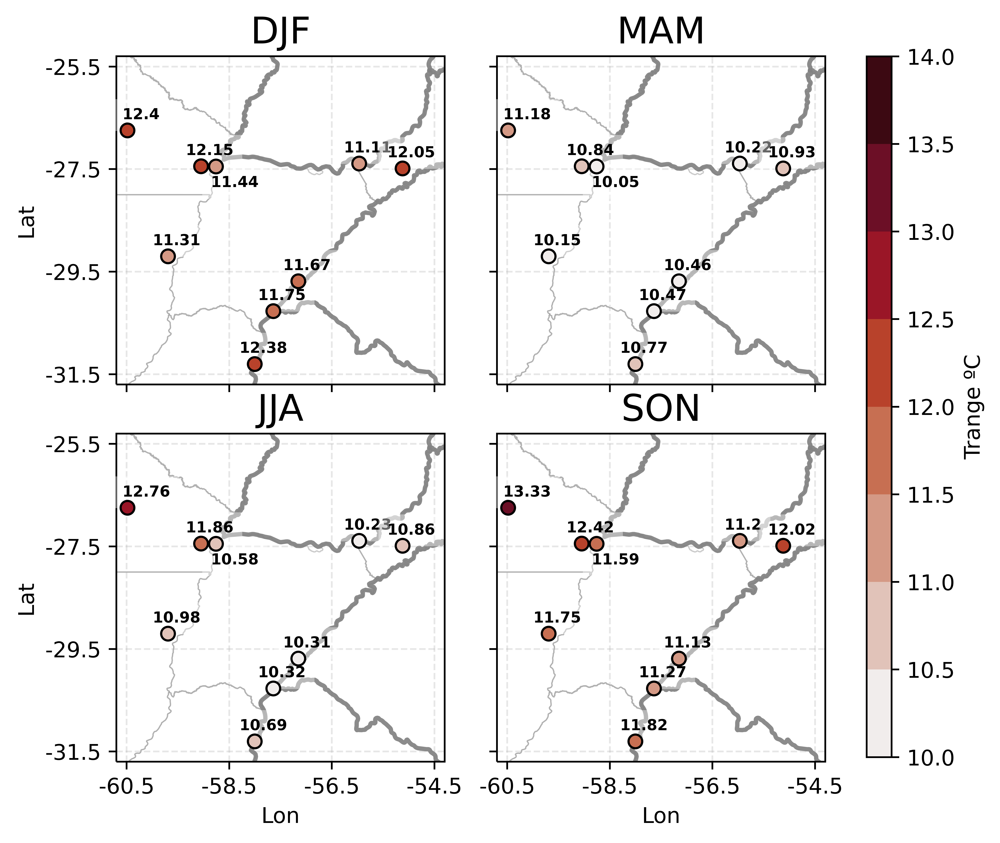

In [60]:
#Grafico medias estacionales

estaciones = ["DJF", "MAM", "JJA", "SON"]
posicion = [221, 222, 223, 224]
medias_DJF_estaciones_ordenadas = [climatologia_estacion_medias_mensuales_smn[i]["DJF"].values[0] for i in ides_omm_ordenado]
medias_MAM_estaciones_ordenadas = [climatologia_estacion_medias_mensuales_smn[i]["MAM"].values[0] for i in ides_omm_ordenado]
medias_JJA_estaciones_ordenadas = [climatologia_estacion_medias_mensuales_smn[i]["JJA"].values[0] for i in ides_omm_ordenado]
medias_SON_estaciones_ordenadas = [climatologia_estacion_medias_mensuales_smn[i]["SON"].values[0] for i in ides_omm_ordenado]
medias_estaciones_ordenadas_list = [medias_DJF_estaciones_ordenadas,medias_MAM_estaciones_ordenadas,medias_JJA_estaciones_ordenadas,medias_SON_estaciones_ordenadas]

def plot_mapa_medias_estacionales():
    valor_minimo = 10
    valor_maximo = 14
    xticks_min = -60.5
    xticks_max = -54.5
    yticks_min = -31.5
    yticks_max = -25.5
    espacio_entre_lat_lon = 1
    fig3b = plt.figure(figsize = [8, 6], dpi = 900) 

    for i in range(0,4):
        ax = fig3b.add_subplot(posicion[i], projection = ccrs.PlateCarree(central_longitude = 0)) #seteo proyeccion

        #agrego geometrias de fondo: provincias y paises
        ax.add_geometries(shape_provincias, crs = ccrs.PlateCarree(), facecolor = 'none',
                          edgecolor = '0.6', linewidth = 0.6, alpha = 0.5, zorder = 1)
        ax.add_geometries(shape_paises, crs = ccrs.PlateCarree(), facecolor = 'none',
                          edgecolor = '0.5', linewidth = 2, alpha = 0.7, zorder = 2)

        #defino puntos a marcar
        geometry_3 = [Point(xy) for xy in lista_puntos_smn_ordenados] #lista con puntos 2
        geodata3 = gpd.GeoDataFrame(lista_puntos_smn_ordenados, geometry = geometry_3)
        geodata3["valores"] = medias_estaciones_ordenadas_list[i]

        mi_cmap = cmocean.cm.amp # define the colormap  rain
        mi_cmaplist = [mi_cmap(i) for i in range(mi_cmap.N)] # extract all colors from the .rain map
        mi_cmap2 = mpl.colors.LinearSegmentedColormap.from_list(
            'Custom cmap', mi_cmaplist, mi_cmap.N) # create the new map
        bounds = np.linspace(valor_minimo, valor_maximo, 9) # define the bins and normalize
        norm = mpl.colors.BoundaryNorm(bounds, mi_cmap2.N)
        ##fin de discretizado de paleta

        geodata3.plot(column= "valores",vmin=valor_minimo, vmax=valor_maximo, 
                      markersize = 40, cmap=mi_cmap2, norm =norm, zorder=4,legend=False, ax = ax, edgecolor = "k") #limites de 0 a 8

        #agrego etiquetas con valores
        list_smn_etiquetas = [(lon-0.3-360, lat+0.30) for lon, lat in lista_puntos_smn_ordenados]
        for j, clave in enumerate(medias_estaciones_ordenadas_list[i]):
            if list(estaciones_ordenadas.values())[j] != "Resistencia" and list(estaciones_ordenadas.values())[j] != "Corrientes" and list(estaciones_ordenadas.values())[j] != "Roque Saenz Peña":
                t = ax.annotate(str(round(clave,2)), (list_smn_etiquetas[j][0],list_smn_etiquetas[j][1]-0.08), size = 7,weight='bold', zorder = 3)
            elif list(estaciones_ordenadas.values())[j] == "Corrientes":
                t = ax.annotate(str(round(clave,2)), (list_smn_etiquetas[j][0]+0.2,list_smn_etiquetas[j][1]-0.7), size = 7,weight='bold', zorder = 3)
            elif list(estaciones_ordenadas.values())[j] == "Roque Saenz Peña":
                t = ax.annotate(str(round(clave,2)), (list_smn_etiquetas[j][0]+0.2,list_smn_etiquetas[j][1]-0.08), size = 7,weight='bold', zorder = 3)
            else:
                t = ax.annotate(str(round(clave,2)), (list_smn_etiquetas[j][0],list_smn_etiquetas[j][1]-0.08) , size = 7,weight='bold', zorder = 3)
            t.set_bbox(dict(facecolor='white', alpha=0.4, edgecolor="none"))

        #agrego titulo a colorbar
        #trans = ax.get_xaxis_transform() # x in data untis, y in axes fraction
        #ann = ax.annotate('Okta', xy=(-52.7, .5 ), xycoords=trans, rotation = 90)

        #seteo ejes
        #x
        ax.set_xlim(xticks_min-0.2, xticks_max+0.2)
        plt.xticks(np.arange(xticks_min, xticks_max+1, 2))
        if i == 0 or i == 1: #saco levels de x para los dos graficos de arriba
            ax.set_xticklabels([])
        else:
            ax.set_xticklabels(np.arange(xticks_min, xticks_max+1, 2))
            ax.set_xlabel("Lon")
        #y 
        ax.set_ylim(yticks_min-0.2, yticks_max+0.2)
        plt.yticks(np.arange(yticks_min, yticks_max+1, 2))
        if i == 1 or i == 3: #saco levels de x para los dos graficos de la derecha
            ax.set_yticklabels([])
        else:
            ax.set_yticklabels(np.arange(yticks_min, yticks_max+1, 2))
            ax.set_ylabel("Lat")
        ax.grid(linestyle="--", alpha=0.3)
        ax.set_title(estaciones[i], size= 17)

    #fig3b.subplots_adjust(right=0.8)
    fig3b.subplots_adjust(wspace=-0.35,hspace=0.15)
    cbar_ax = fig3b.add_axes([0.83, 0.13, 0.02, 0.75])

    sm = plt.cm.ScalarMappable(cmap=mi_cmap2, norm=norm)
    # fake up the array of the scalar mappable. Urgh...
    sm._A = []
    fig3b.colorbar(sm, cax=cbar_ax,label = "Trange ºC")

plot_mapa_medias_estacionales()

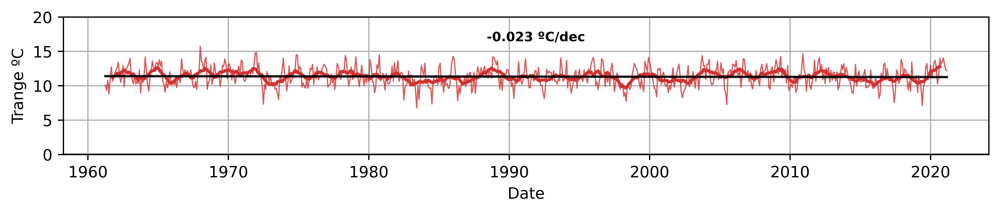

In [64]:
############# 4. SERIE TEMPORAL CON TENDENCIA ###############
#defino funcion que calcula tendencia_theil_sen
import pymannkendall as mk
import scipy

def tendencia_theil_sen(serie):
    valores = serie.values[np.isfinite(serie.values)]
    #fechas = np.arange(0, len(serie), 1)[np.isfinite(serie.values)]
    fechas = np.arange(0, len(valores), 1)
        
    # si el vector es todo de nan entonces que no calcule la tendencia, y que devuelva nan
    if valores.size <= 1:
        tendencia = np.nan
        significativo = np.nan
        
    # si el vector tiene valores distintos de nan calcula tendencia y significancia con 95%
    elif valores.size > 1:
        coef = scipy.stats.mstats.theilslopes(y=valores, x=fechas, alpha=0.95)
        tendencia = coef[0]  # dada entre un intervalo de tiempo. A esta salida si quiero tendencia decadal e ingrese datos de toda la serie mensual lo multiplico por 10*12 y si quiero por decada y vienen dados por un dato anual se multiplica por 10
        coord_origen = coef[1]
        
        ##Hago el test con el z estadistico para alpha = 0.95
        #z_test = mk.original_test(valores, alpha = 0.05)[3]
        #if abs(z_test) >= 1.96:
         #   significativo_95 = True
        #elif abs(z_test) < 1.96:
         #   significativo_95 = False
        
        ##Hago el test con el p-value para y determino si es significativo con alpha = 0.95 o alpha=0.90
        pvalue_test = mk.original_test(valores)[2]
        if pvalue_test <= 0.01:
            significativo_99 = True
            significativo_95 = True
            significativo_90 = True
        elif pvalue_test <= 0.05:
            significativo_99 = False
            significativo_95 = True
            significativo_90 = True
        elif pvalue_test <= 0.1:
            significativo_99 = False
            significativo_95 = False
            significativo_90 = True
        else:
            significativo_99 = False
            significativo_95 = False
            significativo_90 = False        
    return(coord_origen, tendencia, significativo_99, significativo_95, significativo_90, pvalue_test)

#grafico serie con media movil
#calculo media mobil de 12 meses
from f_promedio_movil import f_promedio_movil

def plot_serie_tendencia_media_movil(fecha_inicio, fecha_final):
    #data
    medias_mensuales_smn_media_regional_data = medias_mensuales_smn_media_regional.loc[fecha_inicio:fecha_final]
    ventana = 12
    medias_mensuales_smn_media_regional_media_movil_data = f_promedio_movil(medias_mensuales_smn_media_regional_data, ventana)
    
    fig4b = plt.figure(num=1, figsize=(9, 2), dpi=900)
    
    plt.subplot(1, 1, 1)
    plt.plot(medias_mensuales_smn_media_regional_data, color = "#D23232", linewidth = 0.8, alpha = 0.8)
    plt.plot(medias_mensuales_smn_media_regional_data.index, medias_mensuales_smn_media_regional_media_movil_data, color = "#D23232", linewidth = 2, alpha = 1)

    plt.ylim((0,20))
    plt.ylabel("Trange ºC")
    plt.xlabel("Date")  
    plt.axhline(y=0, color='grey', linestyle='-')
    plt.grid()
    plt.tight_layout()
    #tendencia theil sen
    tendencia_smn_sen = tendencia_theil_sen(medias_mensuales_smn_media_regional_data)
    pendiente_smn_sen = tendencia_smn_sen[1]
    origen_smn_sen = tendencia_smn_sen[0]
    significativo_smn_sen_99 = tendencia_smn_sen[2]
    significativo_smn_sen_95 = tendencia_smn_sen[3]
    significativo_smn_sen_90 = tendencia_smn_sen[4]
    grafico_tendencia_smn_sen = origen_smn_sen + pendiente_smn_sen * np.arange(0, len(medias_mensuales_smn_media_regional_data.index), 1)
    if significativo_smn_sen_99 == True:
        plt.text(8000, 17, f"{round(pendiente_smn_sen*10*12, 3)} ºC/dec ***",color="k", 
                         ha="center", va = "center", fontsize =  'small',
                         weight='bold') #horizontalalignment='center', verticalalignment='center'
    elif significativo_smn_sen_99 == False and significativo_smn_sen_95 == True:
        plt.text(8000, 17, f"{round(pendiente_smn_sen*10*12, 3)} ºC/dec **",color="k", 
                         ha="center", va = "center", fontsize =  'small',
                         weight='bold') #horizontalalignment='center', verticalalignment='center'
    elif significativo_smn_sen_99 == False and significativo_smn_sen_95 == False and significativo_smn_sen_90 == True:
        plt.text(8000, 17, f"{round(pendiente_smn_sen*10*12, 3)} ºC/dec *",color="k", 
                         ha="center", va = "center", fontsize =  'small',
                         weight='bold') #horizontalalignment='center', verticalalignment='center'
    else:
        plt.text(8000, 17, f"{round(pendiente_smn_sen*10*12, 3)} ºC/dec",color="k", 
                         ha="center", va = "center", fontsize =  'small',
                         weight='bold') #horizontalalignment='center', verticalalignment='center'
    plt.plot(medias_mensuales_smn_media_regional_data.index, 
                 grafico_tendencia_smn_sen,color = "k", alpha = 0.9)
    #return(fig4b)

#intervalo temporal 1
fecha_inicio_climatologia_str = "1983-12-01"
fecha_final_climatologia_str = "2016-11-30"
#plot_serie_tendencia_media_movil(fecha_inicio_climatologia_str, fecha_final_climatologia_str)
plt.close()

#intervalo temporal 2 March 1961 to February 2021
fecha_inicio_str = "1961-03-01"
fecha_final_str = "2021-02-28"
plot_serie_tendencia_media_movil(fecha_inicio_str, fecha_final_str)


In [65]:
############### 5. CALCULO DE TENDENCIAS DE THEIL-SEN POR ESTACION PARA LA MEDIA REGIONAL #############

#calculo serie de medias estacionales de la media regional
#smn
#absoluto
#hago medias estacionales y luego hago la media regional de esas series
def calculo_medias_estaciones_smn(serie, estacion = "DJF"):
    serie_fechas = pd.to_datetime(serie.index)
    medias_estacion_list =  [] #donde se van acomodando los datos
    for anio in serie_fechas.year.unique():#iterar sobre los anios
        data_anio = serie[serie.index.year == anio]
        #data_anio = xrdata.sel[dict(time = xrdata.time[serie_fechas.year == anio])]
        if estacion == "DJF":
            try:
                data_anio_previo = serie[serie.index.year == anio-1]
                Dec = data_anio_previo[data_anio_previo.index.month == 12]
                Jan = data_anio[data_anio.index.month == 1]
                Feb = data_anio[data_anio.index.month == 2]
                data_estacion = pd.concat([Dec, Jan, Feb])             
                data_media_estacion = data_estacion.mean(axis=0, skipna=True)
                #data_media_estacion.attrs['time'] = anio
                medias_estacion_list.append(data_media_estacion)
            except IndexError as e:
                print(f"No estan los datos para {anio} para {estacion}, devuelve este error:{e}")
                data_media_estacion = np.nan
        elif estacion == "MAM":
            try:
                Mar = data_anio[data_anio.index.month ==  3]
                Abr = data_anio[data_anio.index.month ==  4]
                May = data_anio[data_anio.index.month ==  5]
                data_estacion = pd.concat([Mar,Abr,May])                
                data_media_estacion = data_estacion.mean(axis=0, skipna=True)
                #data_media_estacion.attrs['time'] = anio
                medias_estacion_list.append(data_media_estacion)
            except IndexError as e:
                print(f"No estan los datos para {anio} para {estacion}, devuelve este error:{e}")
                data_media_estacion = np.nan          
        elif estacion == "JJA":
            try:
                Jun = data_anio[data_anio.index.month == 6]
                Jul = data_anio[data_anio.index.month == 7]
                Ag = data_anio[data_anio.index.month == 8]
                data_estacion = pd.concat([Jun, Jul, Ag])                  
                data_media_estacion = data_estacion.mean(axis=0, skipna=True)
                #data_media_estacion.attrs['time'] = anio
                medias_estacion_list.append(data_media_estacion)        
            except IndexError as e:
                print(f"No estan los datos para {anio} para {estacion}, devuelve este error:{e}")
                data_media_estacion = np.nan   
        elif estacion == "SON":
            try:
                Sep = data_anio[data_anio.index.month == 9]
                Oct = data_anio[data_anio.index.month == 10]
                Nov = data_anio[data_anio.index.month == 11]
                data_estacion = pd.concat([Sep,Oct,Nov])                  
                data_media_estacion = data_estacion.mean(axis=0, skipna=True)
                #data_media_estacion.attrs['time'] = anio
                medias_estacion_list.append(data_media_estacion)
            except IndexError as e:
                print(f"No estan los datos para {anio} para {estacion}, devuelve este error:{e}")
                data_media_estacion = np.nan        
    #xr_medias_estacion = xr.concat(xr_medias_estacion_list, dim = "time")
    medias_estacion_df = pd.DataFrame(medias_estacion_list)
    medias_estacion_df.index = serie_fechas.year.unique()
    return medias_estacion_df
#medias_mensuales_smn_media_regional[medias_mensuales_smn_media_regional.index.month==12]

################ periodo 1983-2016 ################
fecha_inicio_climatologia_str = "1983-12-01"
fecha_final_climatologia_str = "2016-11-30"

#media estacional
series_medias_estacionales_DJF_estaciones_ordenadas = [calculo_medias_estaciones_smn(medias_mensuales_smn[i][fecha_inicio_climatologia_str: fecha_final_climatologia_str], estacion = "DJF") for i in ides_omm_ordenado]
series_medias_estacionales_MAM_estaciones_ordenadas = [calculo_medias_estaciones_smn(medias_mensuales_smn[i][fecha_inicio_climatologia_str: fecha_final_climatologia_str], estacion = "MAM") for i in ides_omm_ordenado]
series_medias_estacionales_JJA_estaciones_ordenadas = [calculo_medias_estaciones_smn(medias_mensuales_smn[i][fecha_inicio_climatologia_str: fecha_final_climatologia_str], estacion = "JJA") for i in ides_omm_ordenado]
series_medias_estacionales_SON_estaciones_ordenadas = [calculo_medias_estaciones_smn(medias_mensuales_smn[i][fecha_inicio_climatologia_str: fecha_final_climatologia_str], estacion = "SON") for i in ides_omm_ordenado]
series_medias_estacionales_estaciones_ordenadas_list = [series_medias_estacionales_DJF_estaciones_ordenadas,
                                                        series_medias_estacionales_MAM_estaciones_ordenadas,
                                                        series_medias_estacionales_JJA_estaciones_ordenadas,
                                                        series_medias_estacionales_SON_estaciones_ordenadas]
#media regional
smn_series_medias_estacionales_media_regional_DJF = pd.concat(series_medias_estacionales_estaciones_ordenadas_list[0], axis = 1).mean(axis = 1, skipna = True)
smn_series_medias_estacionales_media_regional_MAM = pd.concat(series_medias_estacionales_estaciones_ordenadas_list[1], axis = 1).mean(axis = 1, skipna = True)
smn_series_medias_estacionales_media_regional_JJA = pd.concat(series_medias_estacionales_estaciones_ordenadas_list[2], axis = 1).mean(axis = 1, skipna = True)
smn_series_medias_estacionales_media_regional_SON = pd.concat(series_medias_estacionales_estaciones_ordenadas_list[3], axis = 1).mean(axis = 1, skipna = True)

#calculo la tendencia de theil-sen
smn_series_medias_estacionales_media_regional_DJF_tendencia_1983_2016 = tendencia_theil_sen(smn_series_medias_estacionales_media_regional_DJF)
smn_series_medias_estacionales_media_regional_MAM_tendencia_1983_2016 = tendencia_theil_sen(smn_series_medias_estacionales_media_regional_MAM)
smn_series_medias_estacionales_media_regional_JJA_tendencia_1983_2016 = tendencia_theil_sen(smn_series_medias_estacionales_media_regional_JJA)
smn_series_medias_estacionales_media_regional_SON_tendencia_1983_2016 = tendencia_theil_sen(smn_series_medias_estacionales_media_regional_SON)

tabla_tendencias_1983_2016 =  pd.DataFrame({"DJF": [smn_series_medias_estacionales_media_regional_DJF_tendencia_1983_2016[1],smn_series_medias_estacionales_media_regional_DJF_tendencia_1983_2016[5]],
                                              "MAM": [smn_series_medias_estacionales_media_regional_MAM_tendencia_1983_2016[1],smn_series_medias_estacionales_media_regional_MAM_tendencia_1983_2016[5]],
                                              "JJA": [smn_series_medias_estacionales_media_regional_JJA_tendencia_1983_2016[1],smn_series_medias_estacionales_media_regional_JJA_tendencia_1983_2016[5]],
                                              "SON": [smn_series_medias_estacionales_media_regional_SON_tendencia_1983_2016[1],smn_series_medias_estacionales_media_regional_SON_tendencia_1983_2016[5]]}).transpose()
tabla_tendencias_1983_2016.columns = ["1983_2016_tendencia","1983_2016_p_valor"]
tabla_tendencias_1983_2016["1983_2016_tendencia"] = tabla_tendencias_1983_2016["1983_2016_tendencia"]*10
tabla_tendencias_1983_2016.columns = ["1983_2016_tendencia ºC/dec","1983_2016_p_valor"]

#hago lo mismo que antes pero para el periodo 1961-2020
#uso datos de marzo 1961 a febrero 2021 para tener estaciones completas 

fecha_inicio_str = "1961-03-01"
fecha_final_str = "2021-02-28"

series_medias_estacionales_DJF_estaciones_ordenadas_2 = [calculo_medias_estaciones_smn(medias_mensuales_smn[i][fecha_inicio_str: fecha_final_str], estacion = "DJF") for i in ides_omm_ordenado]
series_medias_estacionales_MAM_estaciones_ordenadas_2 = [calculo_medias_estaciones_smn(medias_mensuales_smn[i][fecha_inicio_str: fecha_final_str], estacion = "MAM") for i in ides_omm_ordenado]
series_medias_estacionales_JJA_estaciones_ordenadas_2 = [calculo_medias_estaciones_smn(medias_mensuales_smn[i][fecha_inicio_str: fecha_final_str], estacion = "JJA") for i in ides_omm_ordenado]
series_medias_estacionales_SON_estaciones_ordenadas_2 = [calculo_medias_estaciones_smn(medias_mensuales_smn[i][fecha_inicio_str: fecha_final_str], estacion = "SON") for i in ides_omm_ordenado]
series_medias_estacionales_estaciones_ordenadas_list_2 = [series_medias_estacionales_DJF_estaciones_ordenadas_2,
                                                        series_medias_estacionales_MAM_estaciones_ordenadas_2,
                                                        series_medias_estacionales_JJA_estaciones_ordenadas_2,
                                                        series_medias_estacionales_SON_estaciones_ordenadas_2]

smn_series_medias_estacionales_media_regional_DJF_2 = pd.concat(series_medias_estacionales_estaciones_ordenadas_list_2[0], axis = 1).mean(axis = 1, skipna = True)
smn_series_medias_estacionales_media_regional_MAM_2 = pd.concat(series_medias_estacionales_estaciones_ordenadas_list_2[1], axis = 1).mean(axis = 1, skipna = True)
smn_series_medias_estacionales_media_regional_JJA_2 = pd.concat(series_medias_estacionales_estaciones_ordenadas_list_2[2], axis = 1).mean(axis = 1, skipna = True)
smn_series_medias_estacionales_media_regional_SON_2 = pd.concat(series_medias_estacionales_estaciones_ordenadas_list_2[3], axis = 1).mean(axis = 1, skipna = True)

#calculo la tendencia de theil-sen
smn_series_medias_estacionales_media_regional_DJF_tendencia_1961_2021 = tendencia_theil_sen(smn_series_medias_estacionales_media_regional_DJF_2)
smn_series_medias_estacionales_media_regional_MAM_tendencia_1961_2021 = tendencia_theil_sen(smn_series_medias_estacionales_media_regional_MAM_2)
smn_series_medias_estacionales_media_regional_JJA_tendencia_1961_2021 = tendencia_theil_sen(smn_series_medias_estacionales_media_regional_JJA_2)
smn_series_medias_estacionales_media_regional_SON_tendencia_1961_2021 = tendencia_theil_sen(smn_series_medias_estacionales_media_regional_SON_2)

tabla_tendencias_1961_2021 =  pd.DataFrame({"DJF": [smn_series_medias_estacionales_media_regional_DJF_tendencia_1961_2021[1],smn_series_medias_estacionales_media_regional_DJF_tendencia_1961_2021[5]],
                                              "MAM": [smn_series_medias_estacionales_media_regional_MAM_tendencia_1961_2021[1],smn_series_medias_estacionales_media_regional_MAM_tendencia_1961_2021[5]],
                                              "JJA": [smn_series_medias_estacionales_media_regional_JJA_tendencia_1961_2021[1],smn_series_medias_estacionales_media_regional_JJA_tendencia_1961_2021[5]],
                                              "SON": [smn_series_medias_estacionales_media_regional_SON_tendencia_1961_2021[1],smn_series_medias_estacionales_media_regional_SON_tendencia_1961_2021[5]]}).transpose()
tabla_tendencias_1961_2021.columns = ["1961_2021_tendencia","1961_2021_p_valor"]
tabla_tendencias_1961_2021["1961_2021_tendencia"] = tabla_tendencias_1961_2021["1961_2021_tendencia"]*10
tabla_tendencias_1961_2021.columns = ["1961_2021_tendencia ºC/dec","1961_2021_p_valor"]

tabla_tendencias = pd.concat([tabla_tendencias_1983_2016, tabla_tendencias_1961_2021], axis = 1)
tabla_tendencias

,1983_2016_tendencia ºC/dec,1983_2016_p_valor,1961_2021_tendencia ºC/dec,1961_2021_p_valor
DJF,-0.143110,0.505245,-0.090817,0.243145
MAM,0.218846,0.220930,-0.063244,0.396291
JJA,0.225195,0.167894,0.031940,0.650669
SON,0.105945,0.525252,-0.035656,0.650669


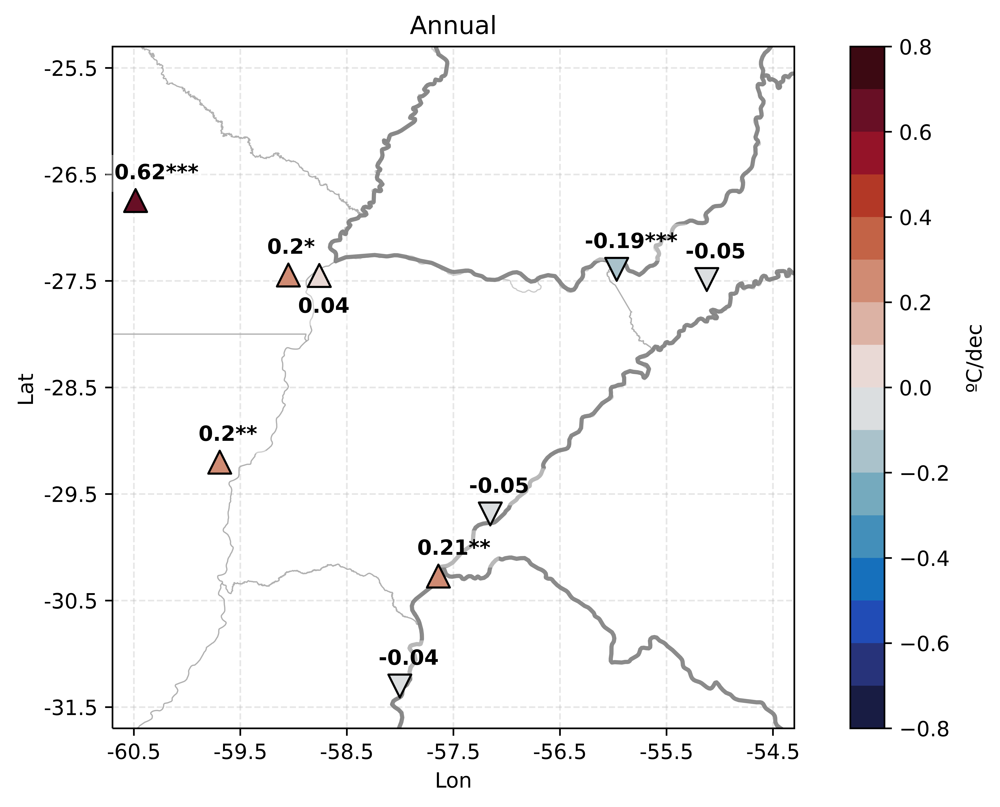

In [66]:
############ 6. MAPA CON TENDENCIAS ANUAL PERIODO CLIMATOLOGICO ##############
from f_mis_shapes import df_paises, df_provincias
import geopandas as gpd
from shapely.geometry import Point
import cartopy.crs as ccrs
import cmocean 
import matplotlib as mpl

fecha_inicio_climatologia_str = "1983-12-01"
fecha_final_climatologia_str = "2016-11-30"

# Calculo tendencia anual de heliofania en periodo climatológico de SMN
tendencia_anual_smn = {} 
for id_omm in ides_omm_ordenado: #para cada id_omm_ordenado
    #calculo climatologia 
    mensual_df = medias_mensuales_smn[id_omm]
    mensual_df.index = pd.to_datetime(medias_mensuales_smn[id_omm].index)
    mensual_fechas_climatologia = mensual_df.loc[fecha_inicio_climatologia_str:fecha_final_climatologia_str]
    mensual_tendencia_anual_theil_sen = tendencia_theil_sen(mensual_fechas_climatologia)
    tendencia_anual_smn[id_omm] = mensual_tendencia_anual_theil_sen #Lo guardo en diccionario: climatologia_anual_medias_mensuales_smn

#puntos que uso
lista_puntos_smn_ordenados = [dict_puntos_smn[list(estaciones_ordenadas.keys())[i]] for i in range(0,9)]
dict_puntos_smn_ordenados = zip(estaciones_ordenadas,lista_puntos_smn_ordenados)

#hago lista con valores de tendencia
tendencias_anuales_estaciones_ordenadas = [tendencia_anual_smn[i][1]*10*12 for i in estaciones_ordenadas.keys()]
#distingo entre mayor a cero, menor e igual a cero porque van a tener distinto simbolo
lista_puntos_smn_mayor_a_cero = []
lista_puntos_smn_menor_a_cero = []
lista_puntos_smn_igual_a_cero = []
for i in range(len(lista_puntos_smn_ordenados)):
    if tendencias_anuales_estaciones_ordenadas[i] < 0:  #tendencias_anuales_estaciones_ordenadas[i] < 0
        lista_puntos_smn_menor_a_cero.append(lista_puntos_smn_ordenados[i])
    elif tendencias_anuales_estaciones_ordenadas[i] > 0:
        lista_puntos_smn_mayor_a_cero.append(lista_puntos_smn_ordenados[i])
    else:
        lista_puntos_smn_igual_a_cero.append(lista_puntos_smn_ordenados[i])
valores_menor_a_cero = [valor for valor in tendencias_anuales_estaciones_ordenadas if valor<0]
valores_mayor_a_cero = [valor for valor in tendencias_anuales_estaciones_ordenadas if valor>0]
valores_igual_a_cero = [valor for valor in tendencias_anuales_estaciones_ordenadas if valor==0]

#hago lista con simbolos de significancia
tendencias_anuales_estaciones_ordenadas = [tendencia_anual_smn[i][1]*10*12 for i in estaciones_ordenadas.keys()]
lista_significancia = []
for est in estaciones_ordenadas.keys():
    if tendencia_anual_smn[est][2] == True:
        lista_significancia.append("***")
    elif tendencia_anual_smn[est][2] == False and tendencia_anual_smn[est][3] == True:
        lista_significancia.append("**")
    elif tendencia_anual_smn[est][2] == False and tendencia_anual_smn[est][3] == False and tendencia_anual_smn[est][4] == True:
        lista_significancia.append("*")
    else:
        lista_significancia.append(" ")

#grafico
def plot_mapa_tendencias():
    valor_minimo = -0.8
    valor_maximo = 0.8
    xticks_min = -60.5
    xticks_max = -54.5
    yticks_min = -31.5
    yticks_max = -25.5
    espacio_entre_lat_lon = 1
    tendencias_anuales_estaciones_ordenadas = [tendencia_anual_smn[i][1]*10*12 for i in ides_omm_ordenado]

    #defino puntos a marcar (distingo entre tendencias positivas, negativas o nulas)
    geometry_1 = [Point(xy) for xy in lista_puntos_smn_igual_a_cero] #lista con puntos 2
    geodata1 = gpd.GeoDataFrame(lista_puntos_smn_igual_a_cero, geometry = geometry_1)
    geodata1["valores"] = valores_igual_a_cero

    geometry_2 = [Point(xy) for xy in lista_puntos_smn_mayor_a_cero] #lista con puntos 2
    geodata2 = gpd.GeoDataFrame(lista_puntos_smn_mayor_a_cero, geometry = geometry_2)
    geodata2["valores"] = valores_mayor_a_cero

    geometry_3 = [Point(xy) for xy in lista_puntos_smn_menor_a_cero] #lista con puntos 2
    geodata3 = gpd.GeoDataFrame(lista_puntos_smn_menor_a_cero, geometry = geometry_3)
    geodata3["valores"] = valores_menor_a_cero

    fig1 = plt.figure(figsize =  [9.6, 6], dpi = 1000)    #dpi = 600
    ax = fig1.add_subplot(111, projection = ccrs.PlateCarree(central_longitude = 0)) #seteo proyeccion

    #agrego geometrias de fondo: provincias y paises
    ax.add_geometries(shape_provincias, crs = ccrs.PlateCarree(), facecolor = 'none',
                          edgecolor = '0.6', linewidth = 0.6, alpha = 0.5, zorder = 1)
    ax.add_geometries(shape_paises, crs = ccrs.PlateCarree(), facecolor = 'none',
                          edgecolor = '0.5', linewidth = 2, alpha = 0.7, zorder = 2)

    ###esto para discretizar la paleta:
    ##
    mi_cmap = cmocean.cm.balance # define the colormap  diff al reves
    ## extract all colors from the .rain map
    mi_cmaplist = [mi_cmap(i) for i in range(mi_cmap.N)]
    ## create the new map
    mi_cmap2 = mpl.colors.LinearSegmentedColormap.from_list(
        'Custom cmap', mi_cmaplist, mi_cmap.N)
    ## define the bins and normalize
    bounds = np.linspace(valor_minimo, valor_maximo, 17)
    norm = mpl.colors.BoundaryNorm(bounds, mi_cmap2.N)
    ##fin de discretizado de paleta

    #grafico puntos
    geodata1.plot(column= "valores",vmin=valor_minimo, vmax=valor_maximo, 
                  markersize = 120, cmap=mi_cmap2, norm =norm, zorder=4,legend=False, ax = ax, 
                  edgecolor = "k", marker='o') #limites de 0 a 8

    geodata2.plot(column= "valores",vmin=valor_minimo, vmax=valor_maximo, 
                  markersize = 120, cmap=mi_cmap2, norm =norm, zorder=4,legend=False, ax = ax, 
                  edgecolor = "k", marker='^') #limites de 0 a 8

    geodata3.plot(column= "valores",vmin=valor_minimo, vmax=valor_maximo, 
                  markersize = 120, cmap=mi_cmap2, norm =norm, zorder=4,legend=True, ax = ax, 
                  edgecolor = "k", marker = "v") #limites de 0 a 8

    #agrego etiquetas con valores
    list_smn_etiquetas = [(lon-0.2-360, lat+0.25) for lon, lat in lista_puntos_smn_ordenados]
    for i, clave in enumerate(tendencias_anuales_estaciones_ordenadas):
        if list(estaciones_ordenadas.values())[i] != "Posadas" and list(estaciones_ordenadas.values())[i] != "Corrientes" and list(estaciones_ordenadas.values())[i] != "Resistencia":
            if round(clave,2) == 0:
                t = ax.annotate(f"{0}{lista_significancia[i]}", (list_smn_etiquetas[i][0]+0.13,list_smn_etiquetas[i][1]-0.05), size = 10,weight='bold', zorder = 3)
            else:
                t = ax.annotate(f"{round(clave,2)}{lista_significancia[i]}", (list_smn_etiquetas[i][0],list_smn_etiquetas[i][1]-0.05), size = 10,weight='bold', zorder = 3)

        elif list(estaciones_ordenadas.values())[i] == "Corrientes":
            if round(clave,2) == 0:
                t = ax.annotate(f"{round(0)}{lista_significancia[i]}", (list_smn_etiquetas[i][0]+0.13,list_smn_etiquetas[i][1]-0.6) , size = 10,weight='bold', zorder = 3)
            else:
                t = ax.annotate(f"{round(clave,2)}{lista_significancia[i]}", (list_smn_etiquetas[i][0],list_smn_etiquetas[i][1]-0.6) , size = 10,weight='bold', zorder = 3)

        elif list(estaciones_ordenadas.values())[i] == "Posadas":
            if round(clave,2) == 0:
                t = ax.annotate(f"{0}{lista_significancia[i]}", (list_smn_etiquetas[i][0]+0.13,list_smn_etiquetas[i][1]-0.05), size = 10,weight='bold', zorder = 3)
            else:
                t = ax.annotate(f"{round(clave,2)}{lista_significancia[i]}", (list_smn_etiquetas[i][0]-0.1,list_smn_etiquetas[i][1]-0.05), size = 10,weight='bold', zorder = 3)

        else:
            if round(clave,2) == 0:
                t = ax.annotate(f"{0}{lista_significancia[i]}", (list_smn_etiquetas[i][0]+0.13,list_smn_etiquetas[i][1]-0.05) , size = 10,weight='bold', zorder = 3)
            else:
                t = ax.annotate(f"{round(clave,2)}{lista_significancia[i]}", (list_smn_etiquetas[i][0],list_smn_etiquetas[i][1]-0.05) , size = 10,weight='bold', zorder = 3)

        t.set_bbox(dict(facecolor='white', alpha=0.4, edgecolor="none"))

    ##agrego titulo a colorbar
    trans = ax.get_xaxis_transform() # x in data untis, y in axes fraction
    ann = ax.annotate('ºC/dec', xy=(-52.7, .5 ), xycoords=trans, rotation = 90)

    #seteo ejes
    ax.set_xlim(xticks_min-0.2, xticks_max+0.2)
    ax.set_xticklabels(np.arange(xticks_min, xticks_max+1))
    plt.xticks(np.arange(xticks_min, xticks_max+1))
    ax.set_xlabel("Lon")
    ax.set_ylim(yticks_min-0.2, yticks_max+0.2)
    ax.set_yticklabels(np.arange(yticks_min, yticks_max+1))
    plt.yticks(np.arange(yticks_min, yticks_max+1))
    ax.set_ylabel("Lat")
    plt.title("Annual")

    plt.grid(linestyle="--", alpha=0.3)

plot_mapa_tendencias() #periodo clim

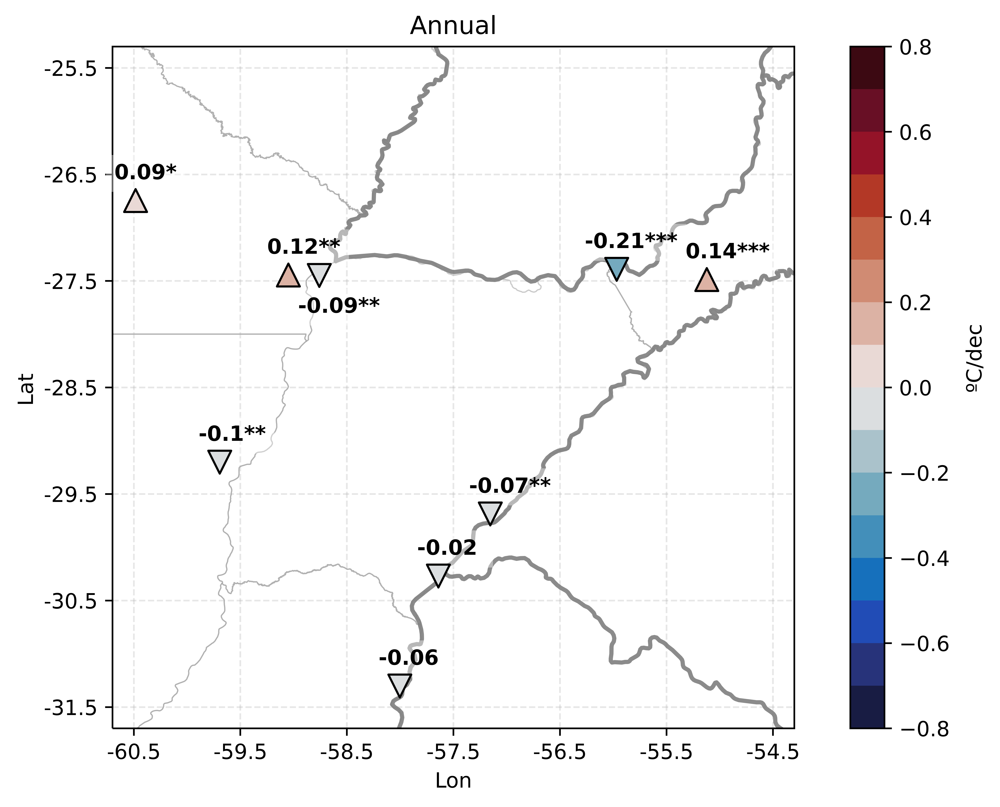

In [67]:
############ 6. MAPA CON TENDENCIAS ANUAL PERIODO A LARGO PLAZO ##############
from f_mis_shapes import df_paises, df_provincias
import geopandas as gpd
from shapely.geometry import Point
import cartopy.crs as ccrs
import cmocean 
import matplotlib as mpl

fecha_inicio_str = "1961-03-01"
fecha_final_str = "2021-02-28"

# Calculo tendencia anual de heliofania en periodo climatológico de SMN
tendencia_anual_smn = {} 
for id_omm in ides_omm_ordenado: #para cada id_omm_ordenado
    #calculo climatologia 
    mensual_df = medias_mensuales_smn[id_omm]
    mensual_df.index = pd.to_datetime(medias_mensuales_smn[id_omm].index)
    mensual_fechas_climatologia = mensual_df.loc[fecha_inicio_str:fecha_final_str]
    mensual_tendencia_anual_theil_sen = tendencia_theil_sen(mensual_fechas_climatologia)
    tendencia_anual_smn[id_omm] = mensual_tendencia_anual_theil_sen #Lo guardo en diccionario: climatologia_anual_medias_mensuales_smn

#puntos que uso
lista_puntos_smn_ordenados = [dict_puntos_smn[list(estaciones_ordenadas.keys())[i]] for i in range(0,9)]
dict_puntos_smn_ordenados = zip(estaciones_ordenadas,lista_puntos_smn_ordenados)

#hago lista con valores de tendencia
tendencias_anuales_estaciones_ordenadas = [tendencia_anual_smn[i][1]*10*12 for i in estaciones_ordenadas.keys()]
#distingo entre mayor a cero, menor e igual a cero porque van a tener distinto simbolo
lista_puntos_smn_mayor_a_cero = []
lista_puntos_smn_menor_a_cero = []
lista_puntos_smn_igual_a_cero = []
for i in range(len(lista_puntos_smn_ordenados)):
    if tendencias_anuales_estaciones_ordenadas[i] < 0:  #tendencias_anuales_estaciones_ordenadas[i] < 0
        lista_puntos_smn_menor_a_cero.append(lista_puntos_smn_ordenados[i])
    elif tendencias_anuales_estaciones_ordenadas[i] > 0:
        lista_puntos_smn_mayor_a_cero.append(lista_puntos_smn_ordenados[i])
    else:
        lista_puntos_smn_igual_a_cero.append(lista_puntos_smn_ordenados[i])
valores_menor_a_cero = [valor for valor in tendencias_anuales_estaciones_ordenadas if valor<0]
valores_mayor_a_cero = [valor for valor in tendencias_anuales_estaciones_ordenadas if valor>0]
valores_igual_a_cero = [valor for valor in tendencias_anuales_estaciones_ordenadas if valor==0]

#hago lista con simbolos de significancia
tendencias_anuales_estaciones_ordenadas = [tendencia_anual_smn[i][1]*10*12 for i in estaciones_ordenadas.keys()]
lista_significancia = []
for est in estaciones_ordenadas.keys():
    if tendencia_anual_smn[est][2] == True:
        lista_significancia.append("***")
    elif tendencia_anual_smn[est][2] == False and tendencia_anual_smn[est][3] == True:
        lista_significancia.append("**")
    elif tendencia_anual_smn[est][2] == False and tendencia_anual_smn[est][3] == False and tendencia_anual_smn[est][4] == True:
        lista_significancia.append("*")
    else:
        lista_significancia.append(" ")

plot_mapa_tendencias()

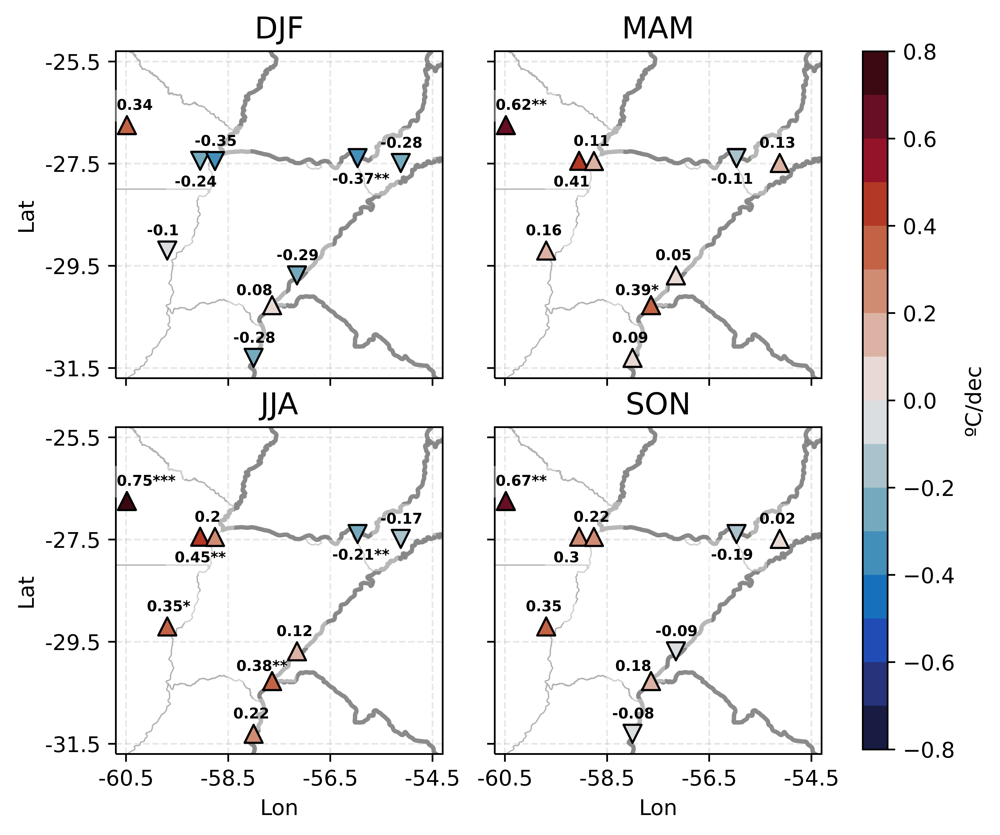

In [68]:
############ 6. MAPA CON TENDENCIAS ESTACIONALES PERIODO CLIMATOLOGICO ##############
fecha_inicio_climatologia_str = "1983-12-01"
fecha_final_climatologia_str = "2016-11-30"

estaciones = ["DJF", "MAM", "JJA", "SON"]
posicion = [221, 222, 223, 224]

lista_puntos_smn_ordenados = [dict_puntos_smn[list(estaciones_ordenadas.keys())[i]] for i in range(0,9)]
dict_puntos_smn_ordenados = zip(estaciones_ordenadas,lista_puntos_smn_ordenados)
lista_puntos_smn_ordenados
list(estaciones_ordenadas.values())[0]    

tendencias_DJF_estaciones_ordenadas = [tendencia_theil_sen(series_medias_estacionales_estaciones_ordenadas_list[0][i])[1]*10 for i in range(len(ides_omm_ordenado))]
tendencias_MAM_estaciones_ordenadas = [tendencia_theil_sen(series_medias_estacionales_estaciones_ordenadas_list[1][i])[1]*10 for i in range(len(ides_omm_ordenado))]
tendencias_JJA_estaciones_ordenadas = [tendencia_theil_sen(series_medias_estacionales_estaciones_ordenadas_list[2][i])[1]*10 for i in range(len(ides_omm_ordenado))]
tendencias_SON_estaciones_ordenadas = [tendencia_theil_sen(series_medias_estacionales_estaciones_ordenadas_list[3][i])[1]*10 for i in range(len(ides_omm_ordenado))]
tendencias_estaciones_ordenadas_list = [tendencias_DJF_estaciones_ordenadas,
                                           tendencias_MAM_estaciones_ordenadas,
                                           tendencias_JJA_estaciones_ordenadas,
                                           tendencias_SON_estaciones_ordenadas]

#significancias
tendencias_DJF_estaciones_ordenadas_significancias = [tendencia_theil_sen(series_medias_estacionales_estaciones_ordenadas_list[0][i]) for i in range(len(ides_omm_ordenado))]
tendencias_MAM_estaciones_ordenadas_significancias = [tendencia_theil_sen(series_medias_estacionales_estaciones_ordenadas_list[1][i]) for i in range(len(ides_omm_ordenado))]
tendencias_JJA_estaciones_ordenadas_significancias = [tendencia_theil_sen(series_medias_estacionales_estaciones_ordenadas_list[2][i]) for i in range(len(ides_omm_ordenado))]
tendencias_SON_estaciones_ordenadas_significancias = [tendencia_theil_sen(series_medias_estacionales_estaciones_ordenadas_list[3][i]) for i in range(len(ides_omm_ordenado))]
tendencias_estaciones_ordenadas_list_significancias = [tendencias_DJF_estaciones_ordenadas_significancias,
                                           tendencias_MAM_estaciones_ordenadas_significancias,
                                           tendencias_JJA_estaciones_ordenadas_significancias,
                                           tendencias_SON_estaciones_ordenadas_significancias]

def plot_mapa_tendencias_estaciones():
    valor_minimo = -0.8
    valor_maximo = 0.8
    xticks_min = -60.5
    xticks_max = -54.5
    yticks_min = -31.5
    yticks_max = -25.5
    espacio_entre_lat_lon = 1
    #fig1, ax = plt.subplots(2, 2, figsize=[9, 7], dpi=600)
    fig1 = plt.figure(figsize = [8, 6], dpi = 900) 

    for i in range(0,4):    
        ###########
        #distingo entre mayor a cero, menor e igual a cero porque van a tener distinto simbolo
        lista_puntos_smn_mayor_a_cero = []
        lista_puntos_smn_menor_a_cero = []
        lista_puntos_smn_igual_a_cero = []
        for j in range(len(lista_puntos_smn_ordenados)):
            if tendencias_estaciones_ordenadas_list[i][j] < 0:
                lista_puntos_smn_menor_a_cero.append(lista_puntos_smn_ordenados[j])
            elif tendencias_estaciones_ordenadas_list[i][j] > 0:
                lista_puntos_smn_mayor_a_cero.append(lista_puntos_smn_ordenados[j])
            elif tendencias_estaciones_ordenadas_list[i][j] == 0:
                lista_puntos_smn_igual_a_cero.append(lista_puntos_smn_ordenados[j])

        valores_menor_a_cero = [valor for valor in tendencias_estaciones_ordenadas_list[i] if valor<0]
        valores_mayor_a_cero = [valor for valor in tendencias_estaciones_ordenadas_list[i] if valor>0]
        valores_igual_a_cero = [valor for valor in tendencias_estaciones_ordenadas_list[i] if valor==0]

        #hago lista con simbolos de significancia
        lista_significancia = []
        for est in range(0, len(estaciones_ordenadas.keys())):
            if tendencias_estaciones_ordenadas_list_significancias[i][est][2] == True:
                lista_significancia.append("***")
            elif tendencias_estaciones_ordenadas_list_significancias[i][est][2] == False and tendencias_estaciones_ordenadas_list_significancias[i][est][3] == True:
                lista_significancia.append("**")
            elif tendencias_estaciones_ordenadas_list_significancias[i][est][2] == False and tendencias_estaciones_ordenadas_list_significancias[i][est][3] == False and tendencias_estaciones_ordenadas_list_significancias[i][est][4] == True:
                lista_significancia.append("*")
            else:
                lista_significancia.append(" ")
        ###########

        ax = fig1.add_subplot(posicion[i], projection = ccrs.PlateCarree(central_longitude = 0)) #seteo proyeccion

        #agrego geometrias de fondo: provincias y paises
        ax.add_geometries(shape_provincias, crs = ccrs.PlateCarree(), facecolor = 'none',
                          edgecolor = '0.6', linewidth = 0.6, alpha = 0.5, zorder = 1)
        ax.add_geometries(shape_paises, crs = ccrs.PlateCarree(), facecolor = 'none',
                          edgecolor = '0.5', linewidth = 2, alpha = 0.7, zorder = 2)

        #defino puntos a marcar los distingo por tendencia positiva negativa o nula

        geometry_1 = [Point(xy) for xy in lista_puntos_smn_igual_a_cero] #lista con puntos 2
        geodata1 = gpd.GeoDataFrame(lista_puntos_smn_igual_a_cero, geometry = geometry_1)
        geodata1["valores"] = valores_igual_a_cero

        geometry_2 = [Point(xy) for xy in lista_puntos_smn_mayor_a_cero] #lista con puntos 2
        geodata2 = gpd.GeoDataFrame(lista_puntos_smn_mayor_a_cero, geometry = geometry_2)
        geodata2["valores"] = valores_mayor_a_cero

        geometry_3 = [Point(xy) for xy in lista_puntos_smn_menor_a_cero] #lista con puntos 2
        geodata3 = gpd.GeoDataFrame(lista_puntos_smn_menor_a_cero, geometry = geometry_3)
        geodata3["valores"] = valores_menor_a_cero

        mi_cmap = cmocean.cm.balance # define the colormap  rain
        # extract all colors from the .rain map
        mi_cmaplist = [mi_cmap(i) for i in range(mi_cmap.N)]
        # create the new map
        mi_cmap2 = mpl.colors.LinearSegmentedColormap.from_list(
            'Custom cmap', mi_cmaplist, mi_cmap.N)
        # define the bins and normalize
        bounds = np.linspace(valor_minimo, valor_maximo, 17)
        norm = mpl.colors.BoundaryNorm(bounds, mi_cmap2.N)
        ##fin de discretizado de paleta

        #grafico puntos
        #geodata3.plot(column= "valores",vmin=valor_minimo, vmax=valor_maximo, 
        #              markersize = 200, cmap=cmocean.cm.rain, zorder=3,legend=True, ax = ax) #limites de 0 a 8

        geodata1.plot(column= "valores",vmin=valor_minimo, vmax=valor_maximo, 
                          markersize = 70, cmap=mi_cmap2, norm =norm, zorder=4,legend=False, ax = ax, 
                      edgecolor = "k", marker = "o") #limites de 0 a 8

        geodata2.plot(column= "valores",vmin=valor_minimo, vmax=valor_maximo, 
                          markersize = 70, cmap=mi_cmap2, norm =norm, zorder=4,legend=False, ax = ax, 
                      edgecolor = "k", marker = '^') #limites de 0 a 8

        geodata3.plot(column= "valores",vmin=valor_minimo, vmax=valor_maximo, 
                          markersize = 70, cmap=mi_cmap2, norm =norm, zorder=4,legend=False, ax = ax, 
                      edgecolor = "k", marker = "v") #limites de 0 a 8

        #agrego etiquetas con valores
        list_smn_etiquetas = [(lon-0.3-360, lat+0.30) for lon, lat in lista_puntos_smn_ordenados]
        for j, clave in enumerate(tendencias_estaciones_ordenadas_list[i]):
            if list(estaciones_ordenadas.values())[j] != "Montecaseros" and list(estaciones_ordenadas.values())[j] != "Resistencia" and list(estaciones_ordenadas.values())[j] != "Posadas" and list(estaciones_ordenadas.values())[j] != "Roque Saenz Peña":
                if round(clave,2) == 0:
                    t = ax.annotate(f"{0}{lista_significancia[j]}", (list_smn_etiquetas[j][0]-0.1,list_smn_etiquetas[j][1]), size = 6.8,weight='bold', zorder = 3)
                else:
                    t = ax.annotate(f"{round(clave,2)}{lista_significancia[j]}", (list_smn_etiquetas[j][0]-0.1,list_smn_etiquetas[j][1]), size = 6.8,weight='bold', zorder = 3) #-0.1
            
            elif list(estaciones_ordenadas.values())[j] == "Roque Saenz Peña":
                if round(clave,2)== 0:
                    t = ax.annotate(f"{0}{lista_significancia[j]}", (list_smn_etiquetas[j][0]+0.1,list_smn_etiquetas[j][1]), size = 6.8,weight='bold', zorder = 3)
                else:
                    t = ax.annotate(f"{round(clave,2)}{lista_significancia[j]}", (list_smn_etiquetas[j][0]+0.1,list_smn_etiquetas[j][1]), size = 6.8,weight='bold', zorder = 3)
            
            elif list(estaciones_ordenadas.values())[j] == "Montecaseros":
                if round(clave,2)== 0:
                    t = ax.annotate(f"{0}{lista_significancia[j]}", (list_smn_etiquetas[j][0]-0.4,list_smn_etiquetas[j][1]-0.1) , size = 6.8,weight='bold', zorder = 3)
                else:
                    t = ax.annotate(f"{round(clave,2)}{lista_significancia[j]}", (list_smn_etiquetas[j][0]-0.4,list_smn_etiquetas[j][1]-0.1) , size = 6.8,weight='bold', zorder = 3)
            
            else:
                if round(clave,2)== 0:
                    t = ax.annotate(f"{0}{lista_significancia[j]}", (list_smn_etiquetas[j][0]-0.2,list_smn_etiquetas[j][1]-0.8) , size = 6.8,weight='bold', zorder = 3)
                else:
                    t = ax.annotate(f"{round(clave,2)}{lista_significancia[j]}", (list_smn_etiquetas[j][0]-0.2,list_smn_etiquetas[j][1]-0.8) , size = 6.8,weight='bold', zorder = 3)
            t.set_bbox(dict(facecolor='white', alpha=0.4, edgecolor="none"))

        #agrego titulo a colorbar
        #trans = ax.get_xaxis_transform() # x in data untis, y in axes fraction
        #ann = ax.annotate('%/dec', xy=(-52.7, .5 ), xycoords=trans, rotation = 90)

        #seteo ejes
        ax.set_xlim(xticks_min-0.2, xticks_max+0.2)
        plt.xticks(np.arange(xticks_min, xticks_max+1, 2))
        if i == 0 or i == 1: #saco levels de x para los dos graficos de arriba
            ax.set_xticklabels([])
        else:
            ax.set_xticklabels(np.arange(xticks_min, xticks_max+1, 2))
            ax.set_xlabel("Lon")


        ax.set_ylim(yticks_min-0.2, yticks_max+0.2)
        plt.yticks(np.arange(yticks_min, yticks_max+1, 2))
        if i == 1 or i == 3: #saco levels de x para los dos graficos de la derecha
            ax.set_yticklabels([])
        else:
            ax.set_yticklabels(np.arange(yticks_min, yticks_max+1, 2))
            ax.set_ylabel("Lat")
        ax.grid(linestyle="--", alpha=0.3)
        ax.set_title(estaciones[i], size= 14)

    #fig1.subplots_adjust(right=0.8)
    fig1.subplots_adjust(wspace=-0.35,hspace=0.15)
    cbar_ax = fig1.add_axes([0.83, 0.13, 0.02, 0.75])

    sm = plt.cm.ScalarMappable(cmap=mi_cmap2, norm=norm)
    # fake up the array of the scalar mappable. Urgh...
    sm._A = []
    fig1.colorbar(sm, cax=cbar_ax,label = "ºC/dec")

plot_mapa_tendencias_estaciones()

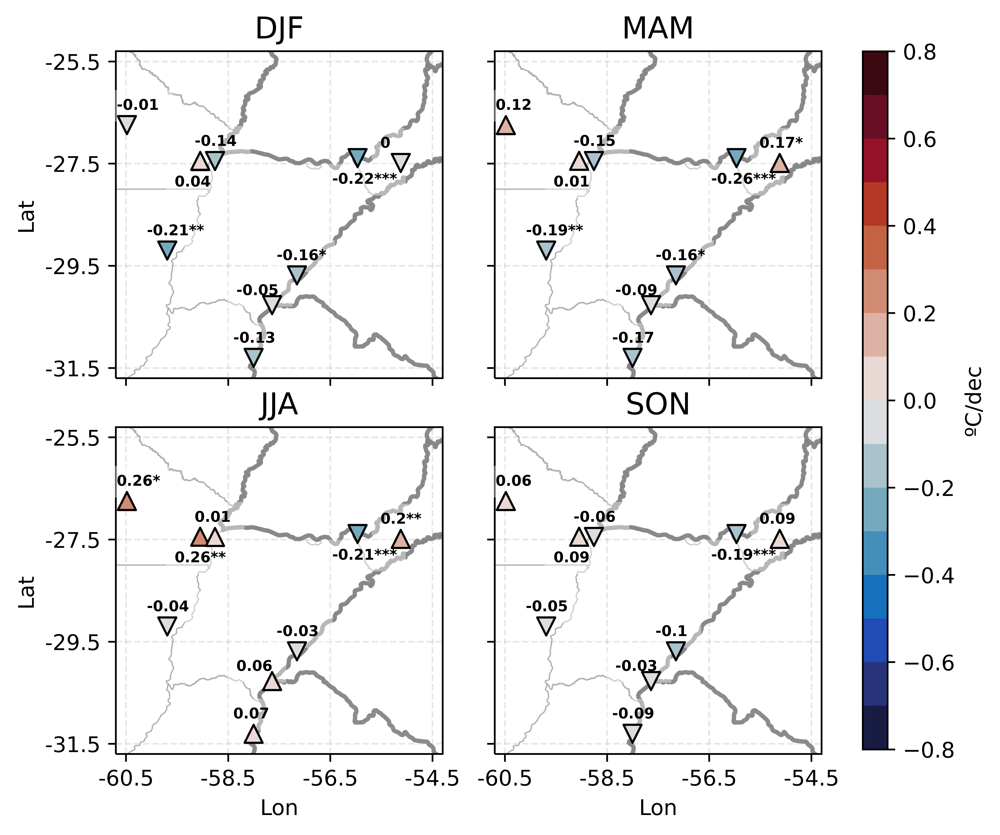

In [69]:
############ 6. MAPA CON TENDENCIAS ESTACIONALES A LARGO PLAZO ##############
fecha_inicio_str = "1961-03-01"
fecha_final_str = "2021-02-28"

estaciones = ["DJF", "MAM", "JJA", "SON"]
posicion = [221, 222, 223, 224]

lista_puntos_smn_ordenados = [dict_puntos_smn[list(estaciones_ordenadas.keys())[i]] for i in range(0,9)]
dict_puntos_smn_ordenados = zip(estaciones_ordenadas,lista_puntos_smn_ordenados)
lista_puntos_smn_ordenados
list(estaciones_ordenadas.values())[0]    

tendencias_DJF_estaciones_ordenadas = [tendencia_theil_sen(series_medias_estacionales_estaciones_ordenadas_list_2[0][i])[1]*10 for i in range(len(ides_omm_ordenado))]
tendencias_MAM_estaciones_ordenadas = [tendencia_theil_sen(series_medias_estacionales_estaciones_ordenadas_list_2[1][i])[1]*10 for i in range(len(ides_omm_ordenado))]
tendencias_JJA_estaciones_ordenadas = [tendencia_theil_sen(series_medias_estacionales_estaciones_ordenadas_list_2[2][i])[1]*10 for i in range(len(ides_omm_ordenado))]
tendencias_SON_estaciones_ordenadas = [tendencia_theil_sen(series_medias_estacionales_estaciones_ordenadas_list_2[3][i])[1]*10 for i in range(len(ides_omm_ordenado))]
tendencias_estaciones_ordenadas_list = [tendencias_DJF_estaciones_ordenadas,
                                           tendencias_MAM_estaciones_ordenadas,
                                           tendencias_JJA_estaciones_ordenadas,
                                           tendencias_SON_estaciones_ordenadas]

#significancias
tendencias_DJF_estaciones_ordenadas_significancias = [tendencia_theil_sen(series_medias_estacionales_estaciones_ordenadas_list_2[0][i]) for i in range(len(ides_omm_ordenado))]
tendencias_MAM_estaciones_ordenadas_significancias = [tendencia_theil_sen(series_medias_estacionales_estaciones_ordenadas_list_2[1][i]) for i in range(len(ides_omm_ordenado))]
tendencias_JJA_estaciones_ordenadas_significancias = [tendencia_theil_sen(series_medias_estacionales_estaciones_ordenadas_list_2[2][i]) for i in range(len(ides_omm_ordenado))]
tendencias_SON_estaciones_ordenadas_significancias = [tendencia_theil_sen(series_medias_estacionales_estaciones_ordenadas_list_2[3][i]) for i in range(len(ides_omm_ordenado))]
tendencias_estaciones_ordenadas_list_significancias = [tendencias_DJF_estaciones_ordenadas_significancias,
                                           tendencias_MAM_estaciones_ordenadas_significancias,
                                           tendencias_JJA_estaciones_ordenadas_significancias,
                                           tendencias_SON_estaciones_ordenadas_significancias]

plot_mapa_tendencias_estaciones()